# Детекция объектов (ноутбук)

> Научимся решать задачу детекции объектов на изображении.

## План ноутбука

1. Семантическая сегментация
1. Практика для семантической сегментации
1. Детекция объектов
1. Практика для детекции объектов

![](1.png)

## Задача семантической сегментации

![](2.png)

### Постановка задачи

 - Данные: изображение и его золотой стандарт сегментации
 - Пример датасетов: PASCAL VOC 2007 и 2012, CITYSCAPES, OXFORDIIITPET

![](3.jpeg)
![](4.png)

### Метрики качества

 - Попиксельная доля верных ответов:
$$\text{Accuracy}(y, a) = \dfrac{1}{n}\sum\limits_{i=1}^{n}[y_i = a_i]$$
 - Мера Жаккара:
$$J_k(y, a) = \dfrac{\sum\limits_{i=1}^{n}[y_i = k][a_i = k]}{\sum\limits_{i=1}^{n}\max([y_i = k], [a_i = k])}$$

![](5.png)

### Функция потерь

Функция потерь абсолютно такая же как и для классификации, только мы классифицируем каждый пиксель и соответственно суммируем ошибку по всем пикселям.

## Архитектуры нейронных сетей для семантической сегментации

### Fully convolutional network

https://arxiv.org/abs/1411.4038

![](6.png)

 - Берем AlexNet
 - Только сверточные слои оставляем
 - Тензор с последнего слоя преобразуем с помощью сверток 1х1 в тензор такого же размера, только с нужным числом каналов (K по числу классов)
 - Повышаем разрешение

![](7.png)

#### Минусы?

 - Тензор на последнем слое маленький
 - Теряется информация о том, где объект, есть только информация, что он там был
 - Объекты похожи на пятна

### U-Net

https://arxiv.org/abs/1505.04597

![](8.png)

## Практика!

In [1]:
import torch
import matplotlib.pyplot as plt

In [2]:
import torchvision.transforms as T
from torchvision.datasets import OxfordIIITPet

dataset = OxfordIIITPet('seminar_4/data', target_types='segmentation', download=False)

In [3]:
dataset[0]

(<PIL.Image.Image image mode=RGB size=394x500>,
 <PIL.PngImagePlugin.PngImageFile image mode=L size=394x500>)

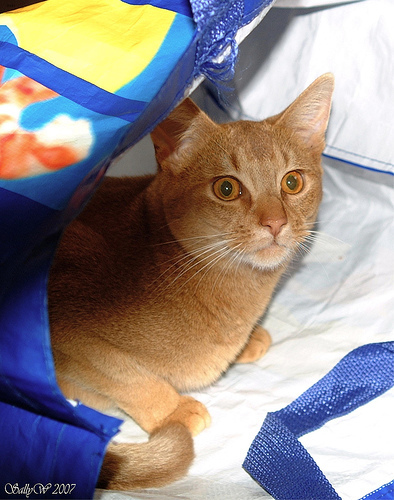

In [4]:
dataset[0][0]

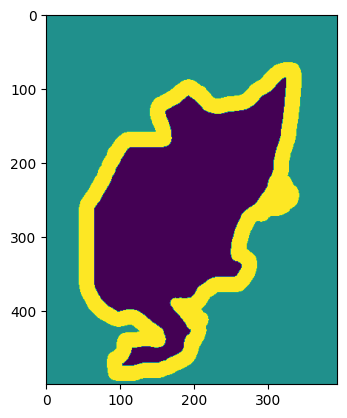

In [5]:
plt.imshow(dataset[0][1])

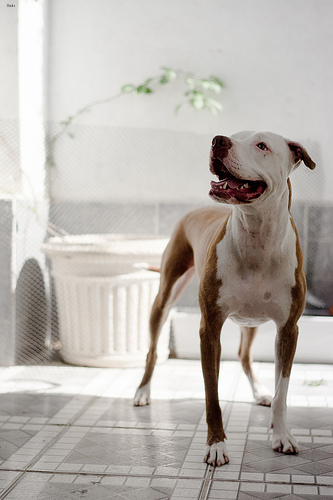

In [6]:
dataset[100][0]

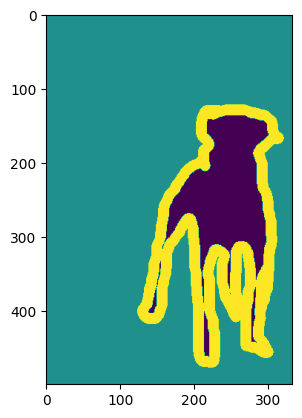

In [7]:
plt.imshow(dataset[100][1])

In [8]:
transform = T.Compose(
    [
        T.Resize((128, 128)),
        T.ToTensor(),
    ]
)

target_transform = T.Compose(
    [
        T.Resize((128, 128)),
        T.PILToTensor(),
        T.Lambda(lambda x: (x - 1).long())
    ]
)

train_dataset = OxfordIIITPet('seminar_4/data', transform=transform, target_transform=target_transform, target_types='segmentation')
valid_dataset = OxfordIIITPet('seminar_4/data', transform=transform, split='test', target_transform=target_transform, target_types='segmentation')

In [9]:
from torch.utils.data import DataLoader

train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True, num_workers=8, pin_memory=True)
valid_loader = DataLoader(valid_dataset, batch_size=64, shuffle=True, num_workers=8, pin_memory=True)

In [10]:
train_dataset[0][0].shape, train_dataset[0][1].shape

(torch.Size([3, 128, 128]), torch.Size([1, 128, 128]))

In [11]:
torch.unique(train_dataset[0][1])

tensor([0, 1, 2])

In [31]:
from tqdm import tqdm
import torchmetrics

def train(model) -> float:
    model.train()

    train_loss = 0
    total = 0
    correct = 0
    
    iou_metric = torchmetrics.JaccardIndex(task='multiclass', num_classes=3, ignore_index=2).to(device)

    for x, y in tqdm(train_loader, desc='Train'):
        bs = y.size(0)

        x, y = x.to(device), y.squeeze(1).to(device)

        optimizer.zero_grad()

        output = model(x)

        loss = loss_fn(output.reshape(bs, 3, -1), y.reshape(bs, -1))

        train_loss += loss.item()

        loss.backward()

        optimizer.step()

        _, y_pred = output.max(dim=1)
        total += y.size(0) * y.size(1) * y.size(2)
        correct += (y == y_pred).sum().item()
        iou_metric.update(output, y)

    train_loss /= len(train_loader)
    accuracy = correct / total

    return train_loss, accuracy, iou_metric.compute().item()

In [32]:
@torch.inference_mode()
def evaluate(model, loader):
    model.eval()

    total_loss = 0
    total = 0
    correct = 0
    iou_metric = torchmetrics.JaccardIndex(task='multiclass', num_classes=3, ignore_index=2).to(device)

    for x, y in tqdm(loader, desc='Evaluation'):
        bs = y.size(0)

        x, y = x.to(device), y.squeeze(1).to(device)

        output = model(x)

        loss = loss_fn(output.reshape(bs, 3, -1), y.reshape(bs, -1))

        total_loss += loss.item()

        _, y_pred = output.max(dim=1)
        total += y.size(0) * y.size(1) * y.size(2)
        correct += (y == y_pred).sum().item()
        iou_metric.update(output, y)

    total_loss /= len(loader)
    accuracy = correct / total

    return total_loss, accuracy, iou_metric.compute().item()

In [14]:
from IPython.display import clear_output


def plot_stats(
    train_loss,
    valid_loss,
    train_accuracy,
    valid_accuracy,
    title
):
    plt.figure(figsize=(16, 8))

    plt.title(title + ' loss')

    plt.plot(train_loss, label='Train loss')
    plt.plot(valid_loss, label='Valid loss')
    plt.legend()
    plt.grid()

    plt.show()

    plt.figure(figsize=(16, 8))

    plt.title(title + ' accuracy')
    
    plt.plot(train_accuracy, label='Train accuracy')
    plt.plot(valid_accuracy, label='Valid accuracy')
    plt.legend()
    plt.grid()

    plt.show()

In [15]:
import numpy as np
from PIL import Image


@torch.inference_mode()
def visualize(model, batch):
    model.eval()

    xs, ys = batch
    
    to_pil = T.ToPILImage()

    for i, (x, y) in enumerate(zip(xs, ys)):
        prediction = model(x.unsqueeze(0).cuda()).squeeze(0).max(dim=0)[1]

        fig, ax = plt.subplots(1, 3, figsize=(24, 8), facecolor='white')

        ax[0].imshow(to_pil(x))
        ax[1].imshow(to_pil(y.to(torch.uint8)))
        ax[2].imshow(to_pil(prediction.to(torch.uint8)))

        ax[0].axis('off')
        ax[1].axis('off')
        ax[2].axis('off')

        ax[0].set_title('Original image')
        ax[1].set_title('Segmentation mask')
        ax[2].set_title('Prediction')

        plt.subplots_adjust(wspace=0, hspace=0.1)
        plt.show()

        if i >= 9:
            break

In [27]:
def whole_train_valid_cycle(model, num_epochs, title):
    train_loss_history, valid_loss_history = [], []
    train_iou_history, valid_iou_history = [], []

    for epoch in range(num_epochs):
        train_loss, train_accuracy, train_iou = train(model)
        valid_loss, valid_accuracy, valid_iou = evaluate(model, valid_loader)

        train_loss_history.append(train_loss)
        valid_loss_history.append(valid_loss)

        train_iou_history.append(train_iou)
        valid_iou_history.append(valid_iou)

        clear_output()

        plot_stats(
            train_loss_history, valid_loss_history,
            train_iou_history, valid_iou_history,
            title
        )

        visualize(model, next(iter(valid_loader)))

In [17]:
import torch.nn as nn


def conv_plus_conv(in_channels: int, out_channels: int):
    """
    Makes UNet block
    :param in_channels: input channels
    :param out_channels: output channels
    :return: UNet block
    """
    return nn.Sequential(
        nn.Conv2d(
            in_channels=in_channels,
            out_channels=out_channels,
            kernel_size=3,
            stride=1,
            padding=1
        ),
        nn.BatchNorm2d(num_features=out_channels),
        nn.LeakyReLU(0.2),
        nn.Conv2d(
            in_channels=out_channels,
            out_channels=out_channels,
            kernel_size=3,
            stride=1,
            padding=1
        ),
        nn.BatchNorm2d(num_features=out_channels),
        nn.LeakyReLU(0.2),
    )


class UNET(nn.Module):
    def __init__(self):
        super().__init__()

        base_channels = 16

        self.down1 = conv_plus_conv(3, base_channels)
        self.down2 = conv_plus_conv(base_channels, base_channels * 2)

        self.up1 = conv_plus_conv(base_channels * 2, base_channels)
        self.up2 = conv_plus_conv(base_channels * 4, base_channels)

        self.bottleneck = conv_plus_conv(base_channels * 2, base_channels * 2)

        self.out = nn.Conv2d(in_channels=base_channels, out_channels=3, kernel_size=1)

        self.downsample = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        # x.shape = (N, N, 3)

        residual1 = self.down1(x)  # x.shape: (N, N, 3) -> (N, N, base_channels)
        x = self.downsample(residual1)  # x.shape: (N, N, base_channels) -> (N // 2, N // 2, base_channels)

        residual2 = self.down2(x)  # x.shape: (N // 2, N // 2, base_channels) -> (N // 2, N // 2, base_channels * 2)
        x = self.downsample(residual2)  # x.shape: (N // 2, N // 2, base_channels * 2) -> (N // 4, N // 4, base_channels * 2)

        # LATENT SPACE DIMENSION DIM = N // 4
        # SOME MANIPULATION MAYBE
        x = self.bottleneck(x)  # x.shape: (N // 4, N // 4, base_channels * 2) -> (N // 4, N // 4, base_channels * 2)
        # SOME MANIPULATION MAYBE
        # LATENT SPACE DIMENSION DIM = N // 4

        x = nn.functional.interpolate(x, scale_factor=2)  # x.shape: (N // 4, N // 4, base_channels * 2) -> (N // 2, N // 2, base_channels * 2)
        x = torch.cat((x, residual2), dim=1)  # x.shape: (N // 2, N // 2, base_channels * 2) -> (N // 2, N // 2, base_channels * 4)
        x = self.up2(x)  # x.shape: (N // 2, N // 2, base_channels * 4) -> (N // 2, N // 2, base_channels)

        x = nn.functional.interpolate(x, scale_factor=2)  # x.shape: (N // 2, N // 2, base_channels) -> (N, N, base_channels)
        x = torch.cat((x, residual1), dim=1)  # x.shape: (N, N, base_channels) -> (N, N, base_channels * 2)
        x = self.up1(x)  # x.shape: (N, N, base_channels * 2) -> (N, N, base_channels)

        x = self.out(x).squeeze()  # x.shape: (N, N, base_channels) -> (N, N, 3)

        return x

In [18]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

print(device)
print(torch.cuda.get_device_name())

loss_fn = nn.CrossEntropyLoss()

cuda:0
NVIDIA GeForce RTX 3090


In [19]:
from torch.optim import Adam
from tqdm.notebook import tqdm

model = UNET().to(device)
optimizer = Adam(model.parameters(), lr=1e-3)

In [20]:
plt.rcParams.update({'font.size': 16})

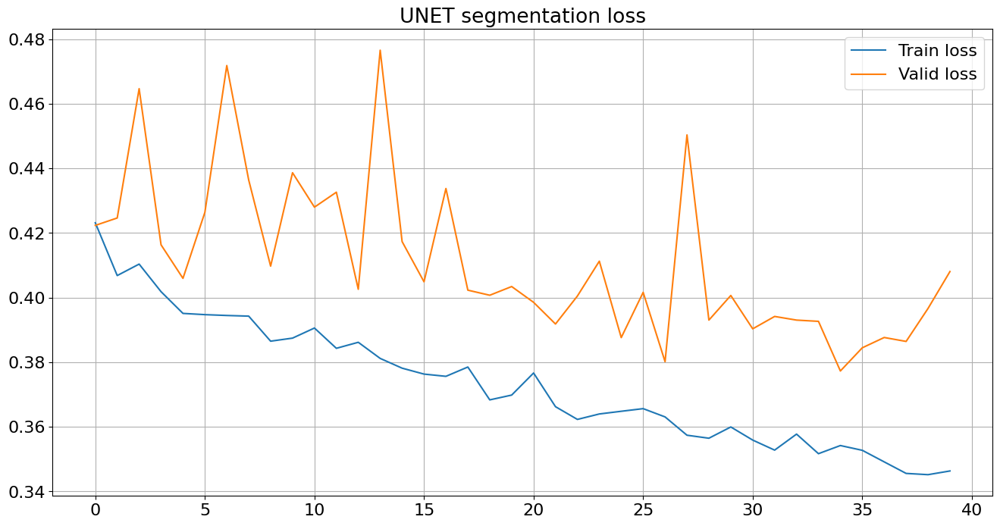

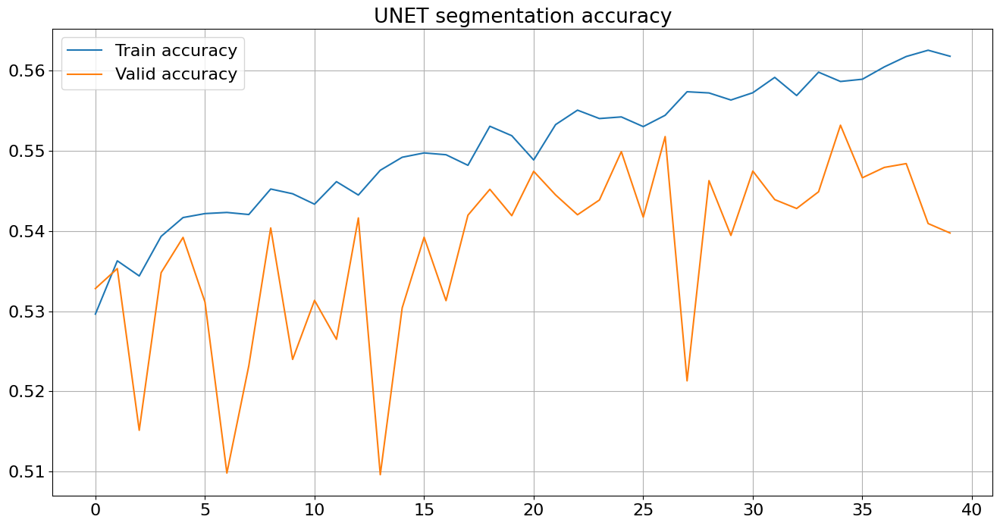

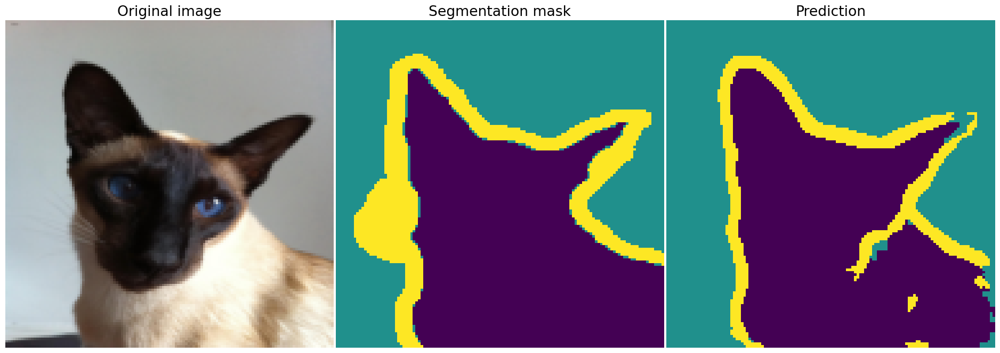

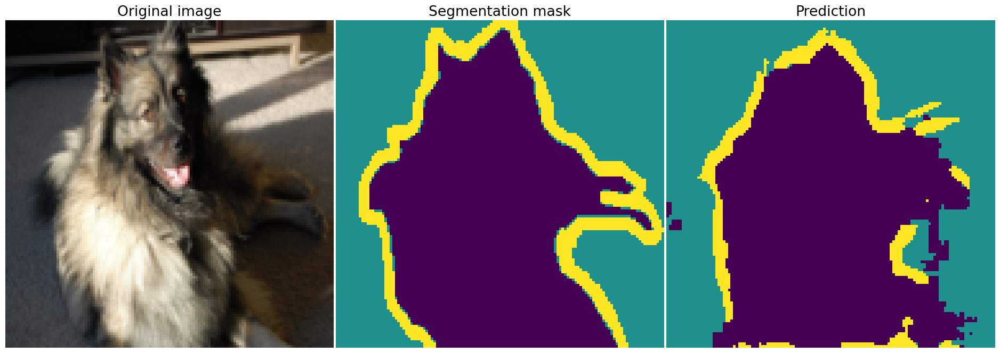

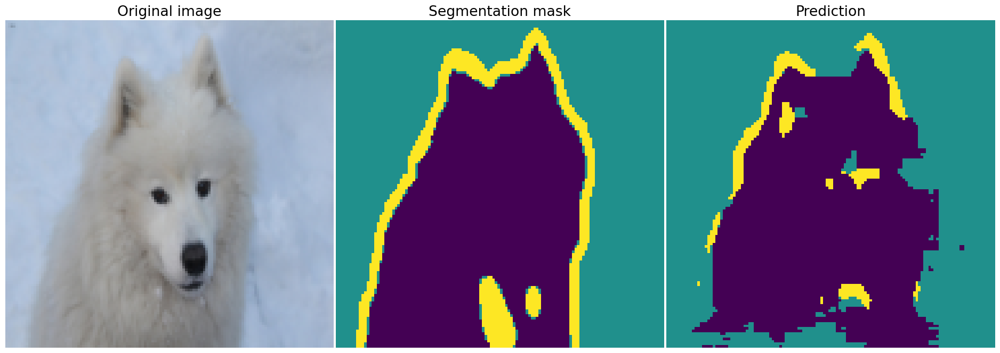

...

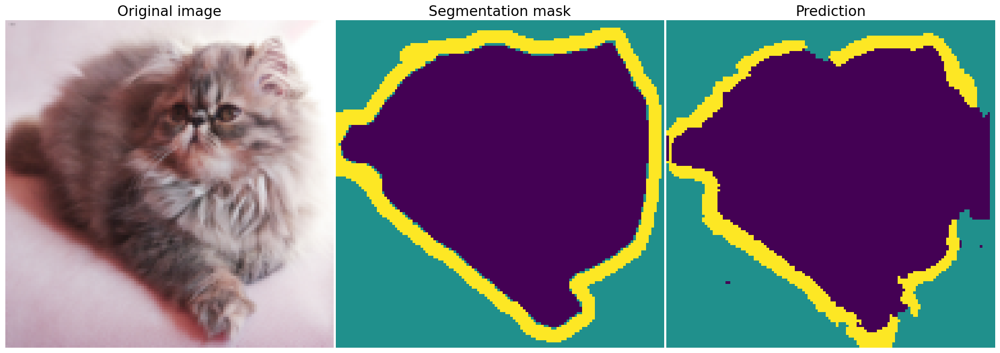

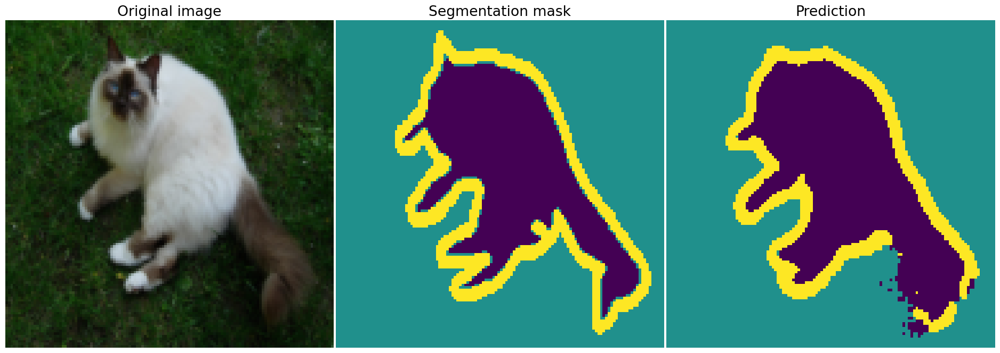

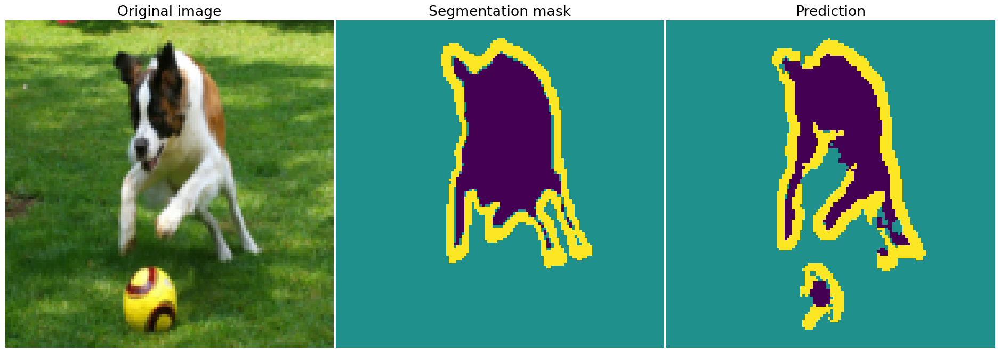

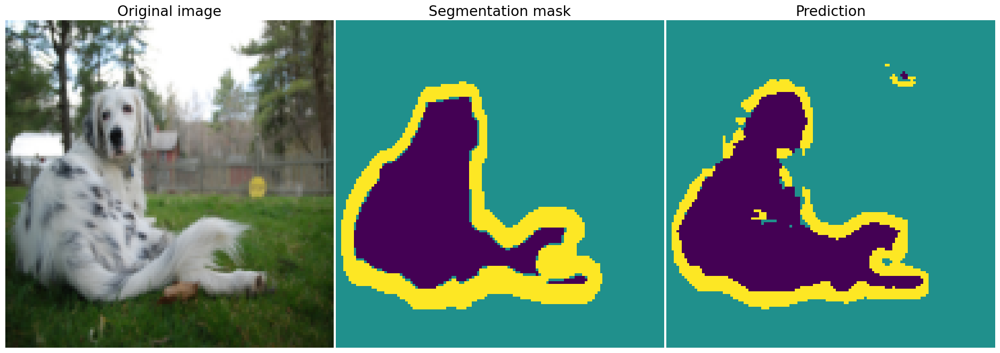

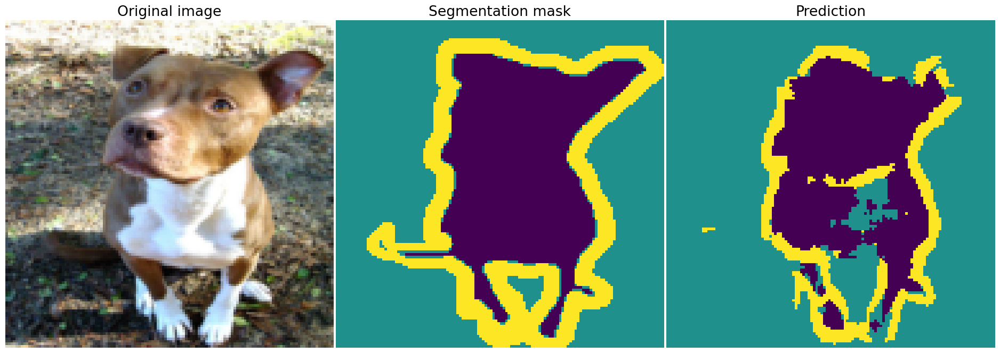

In [34]:
whole_train_valid_cycle(model, 40, 'UNET segmentation')

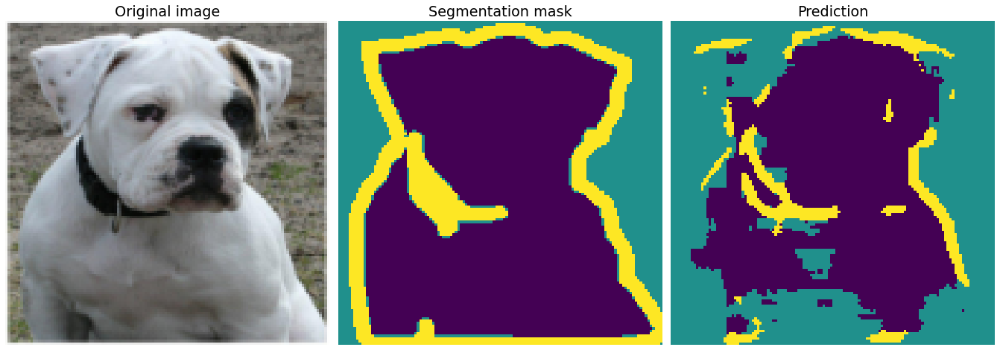

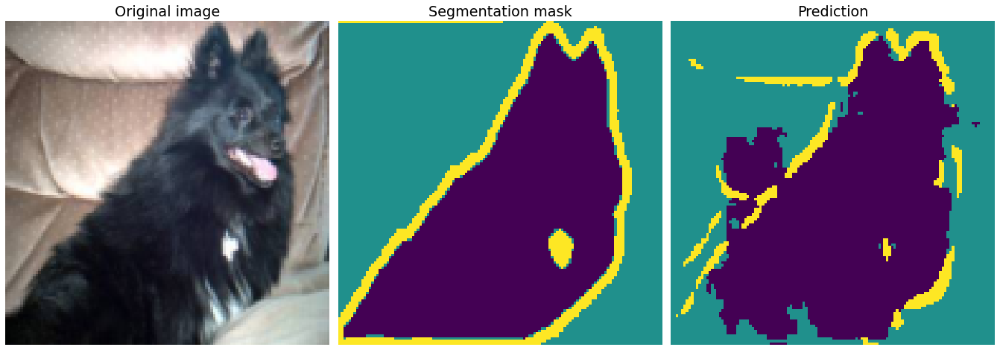

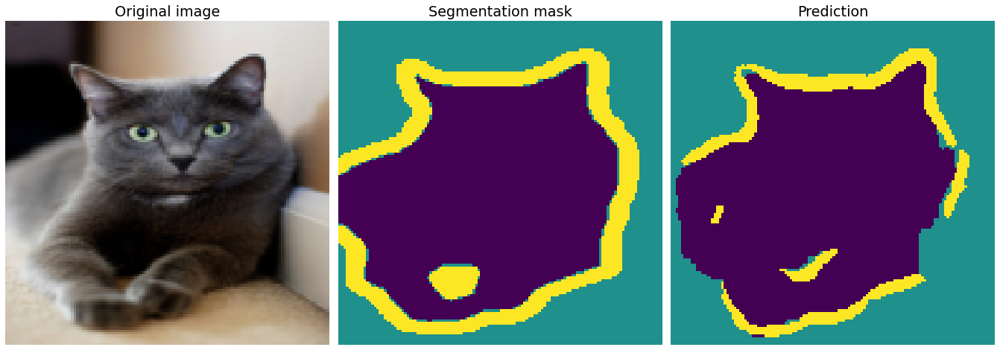

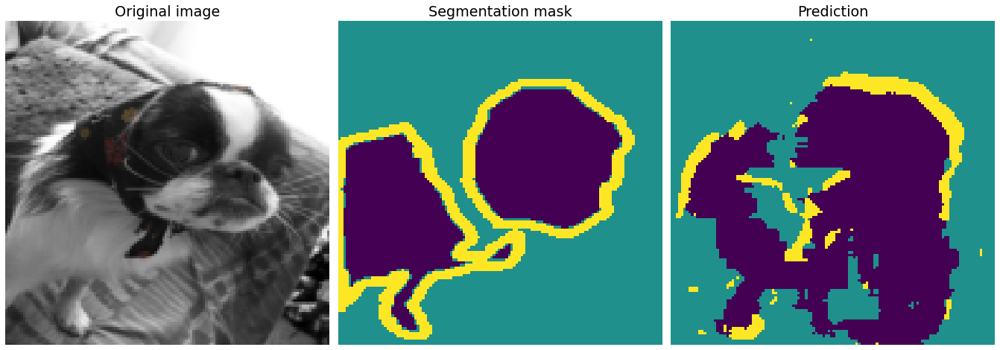

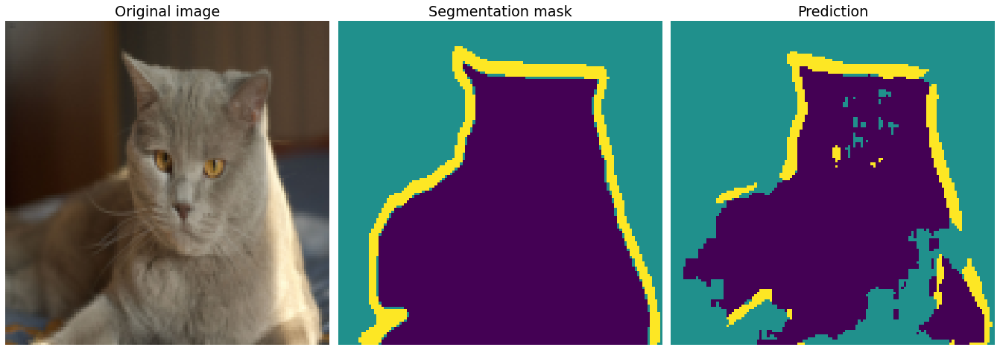

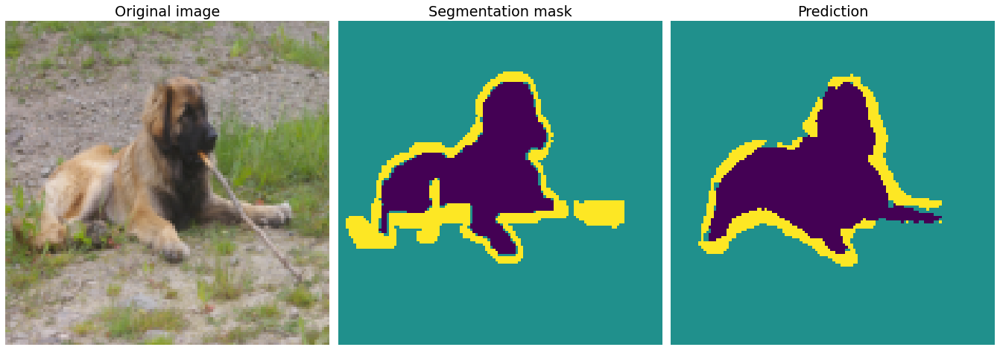

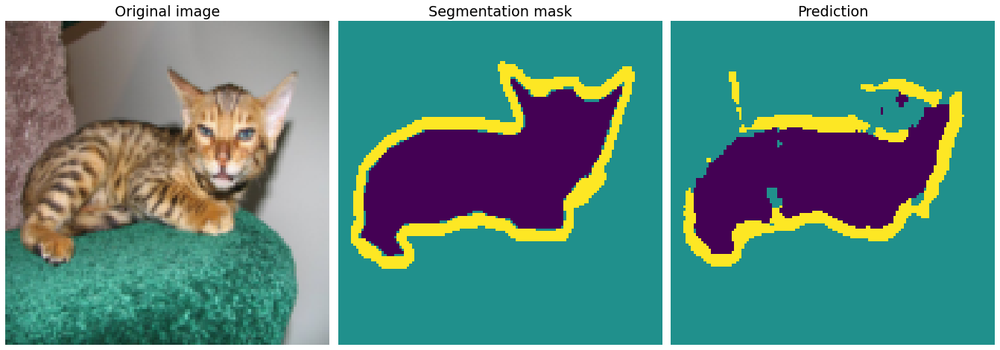

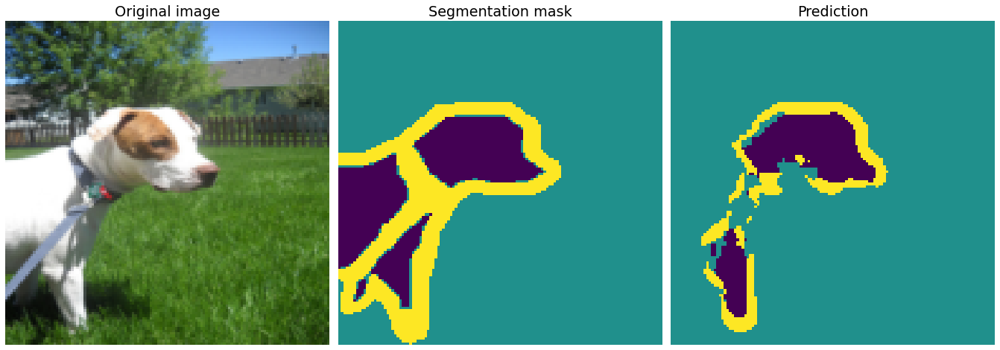

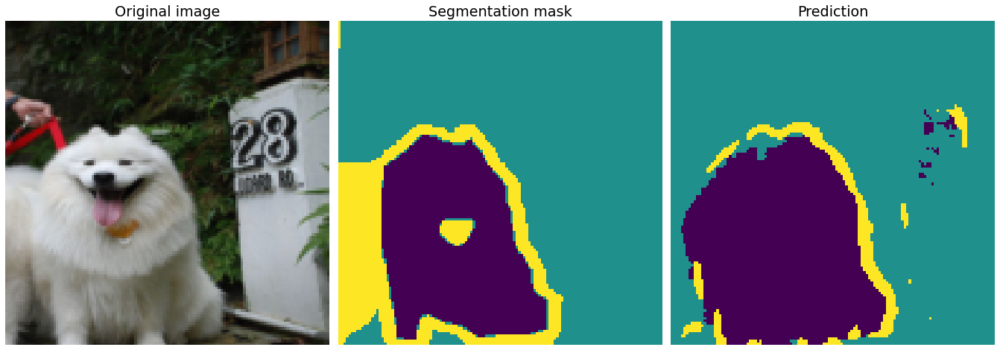

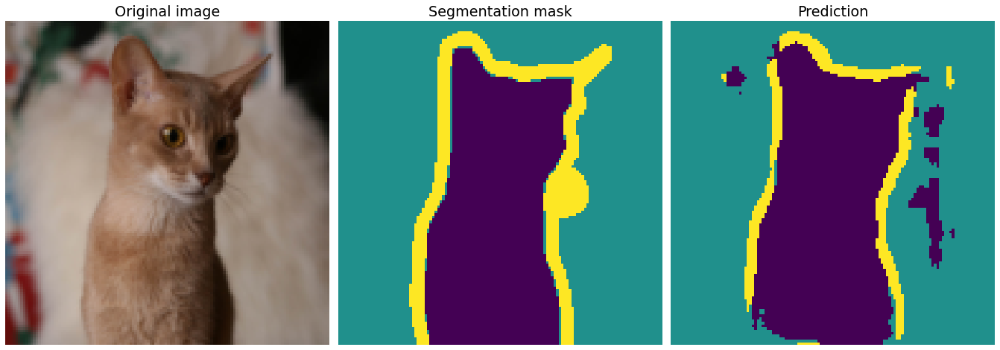

In [29]:
visualize(model, next(iter(train_loader)))

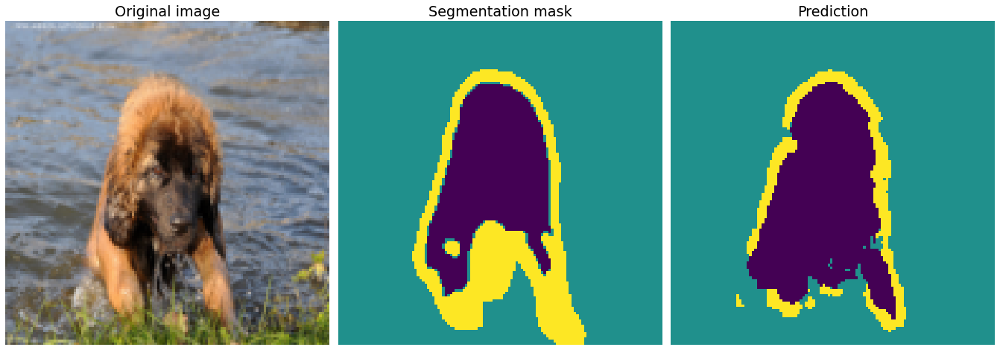

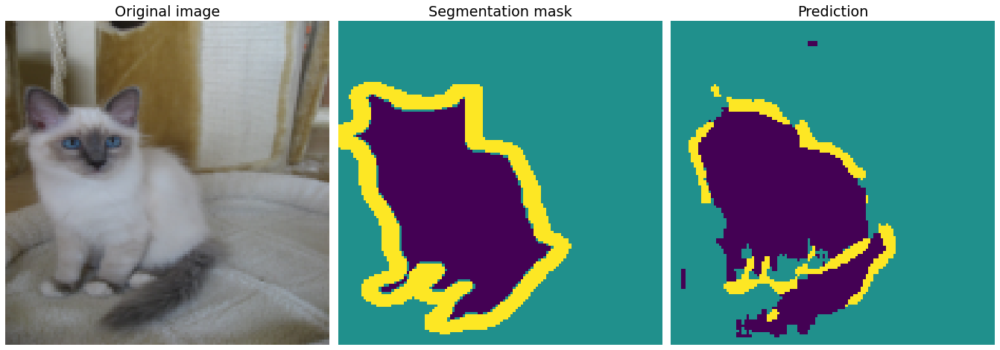

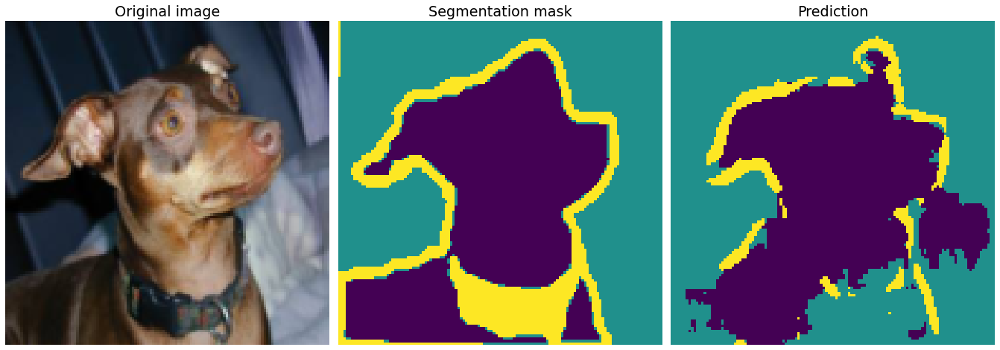

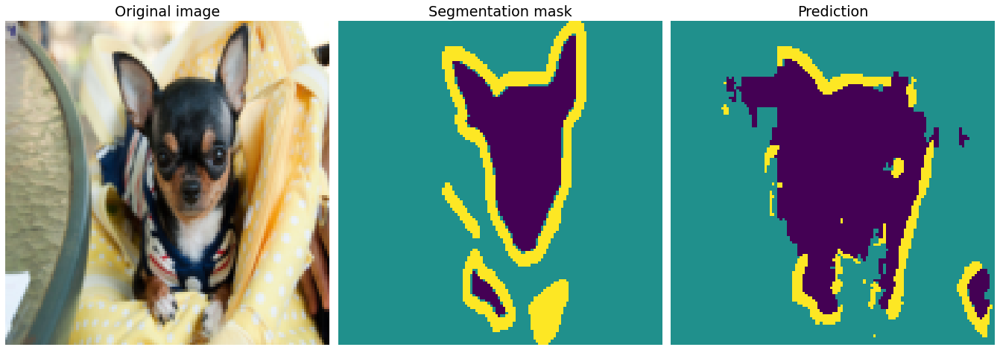

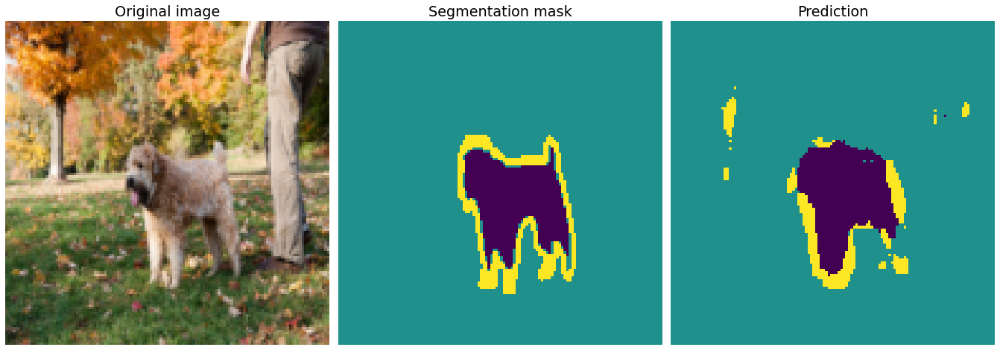

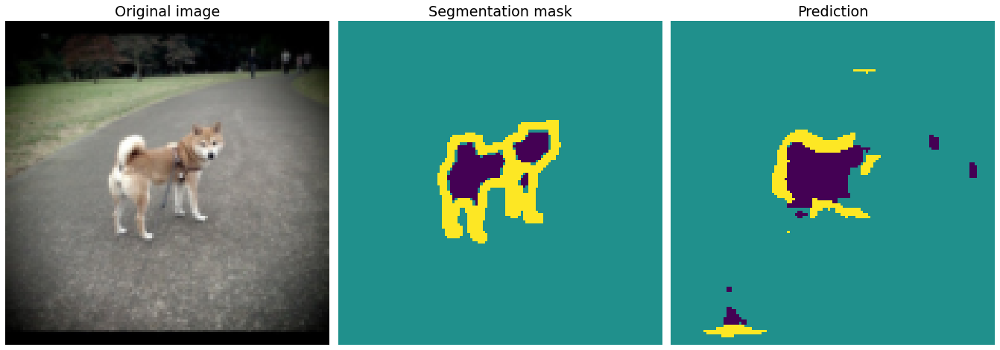

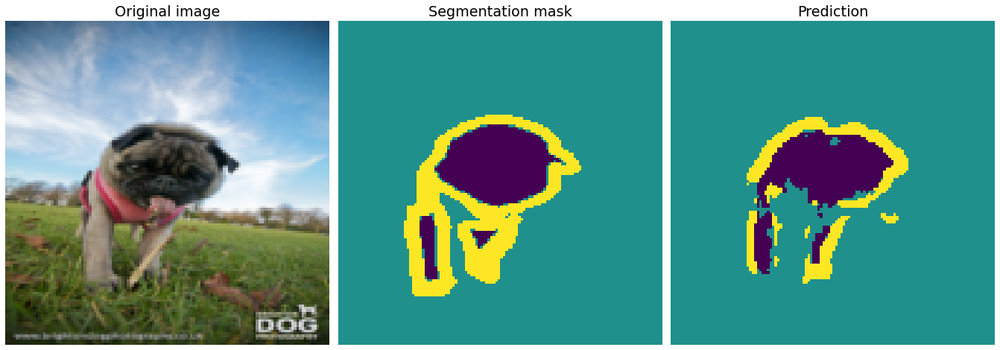

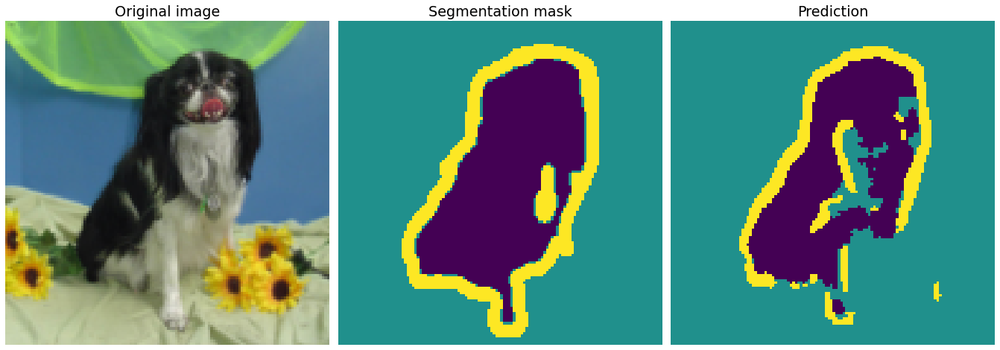

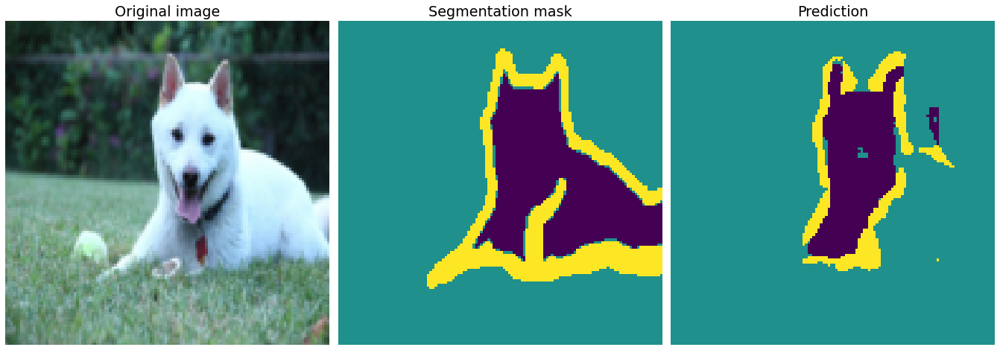

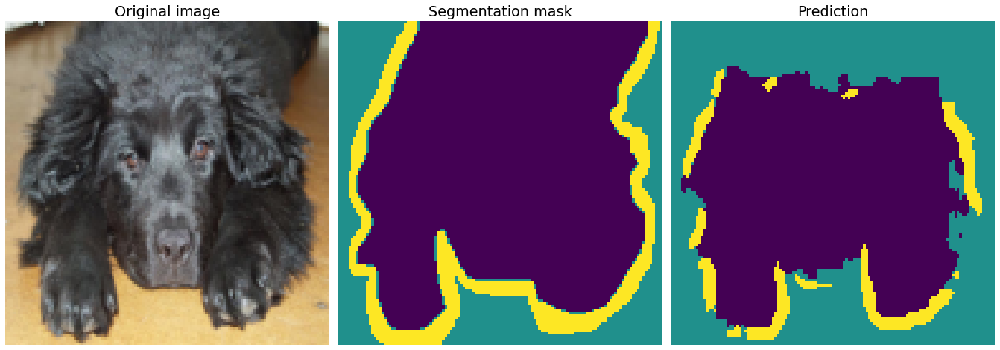

In [30]:
visualize(model, next(iter(valid_loader)))

## Задача детекции

![](9.jpeg)

### Постановка задачи

 - Данные: изображение и прямоугольники (bounding boxes) ограничивающие положение объектов нескольких классов на изображении
 - Пример датасетов: COCODETECTION, OXFORDIIITPET, PASCAL VOC 2007 и 2012

http://host.robots.ox.ac.uk/pascal/VOC/

![](10.png)

### Non-maximum supression

 - Модель выдает для конкретного класса список прямоугольников с уверенностями
 - Сортируем по уверенности, идем от большой к маленькой
 - Для каждого прямоугольника удаляем все последующие, с которыми IoU > 0.5


![](5.png)


![](11.png)


![](13.png)

### Метрики качества

 - Модель выдает для каждого класса список прямоугольников с уверенностями
 - Считаем прямоугольник корректным, если IoU(y, a) = Jaccard(y, a) > 0.5

$$\text{Precision} = \dfrac{TP}{TP + FP}$$
$$\text{Recall} = \dfrac{TP}{TP + FN}$$

![](12.png)

Precision - доля положительных объектов среди всех объектов, которые классификатор назвал положительными.

Recall - доля названных классификатором положительными среди всех объектов, которые являются положительными.

Как выдаем метки TP, FP, FN:

 - Метка TP выдается в том случае, если IoU > 0.5 и класс определен правильно
 - Метка FP выдается в том случае, если IoU <= 0.5
 - Метка FN выдается в том случае, если IoU > 0.5, но неправильно определен класс или если бокса нет совсем

Раньше брали порог в 0.5, сейчас архитектуры и подходы становятся все совершеннее, поэтому берут порог в 0.75.

 - Строим PR-кривую, затем считаем под ней площадь, получаем Average Precision

![](14.png)
![](15.png)
![](16.png)
 - Усредняем по всем классам, получаем mean Average Precision (mAP)

## Архитектуры нейронных сетей для детекции объектов

### Two-shot detection

Двух-этапное решение задачи:

 1. Найти "кандидатов" - прямоугольники, где скорее всего что-то есть
 2. Классифицировать эти прямоугольники

### R-CNN

https://arxiv.org/abs/1311.2524

![](17.png)

![](18.png)

 - Для генерации кандидатов используются внешние методы из классического компьютерного зрения
 - Выбирается около 2000 прямоугольников

![](19.png)
 - В качестве признаков используются выходы предпоследнего слоя AlexNet (4096)
 - Для классификации SVM one-vs-all

#### Проблемы

 - Не end-to-end $\Rightarrow$ не глубинное обучение
 - Генерация кандидатов очень долгая и сложная
 - Сверточная сеть почти не настраивается под данные
 - Всё в целом работает долго

### Fast R-CNN

https://arxiv.org/abs/1504.08083

![](20.png)

![](21.png)

![](22.png)

 - Исправили почти все проблемы R-CNN
 - Всё равно остался отбор кандидатов
 - Из-за этого работает дольше, это боттлнек

### Faster R-CNN

https://arxiv.org/abs/1506.01497

![](23.png)
![](24.png)

#### Region Proposal Network (RPN)
 - Берем последний тензор из сверточной сети
 - Применяем большой сверточный слой (ядро 3 на 3 и большое количество каналов 512)
 - Для каждой точки берем 9 прямоугольников с разными длинами сторон и соотношениями сторон
 - Для каждого из этих 9 предсказываем есть ли там объект и 4 поправки к сторонам

Сама модель собственно:
 - Всё обучается end-to-end, совместно на сумму из 4 функций потерь
    - Есть ли объект в RPN
    - Регрессия для корректировки размеров прямоугольника в RPN
    - Классификация на K классов в основной модели
    - Регрессия для корректировки прямоугольника в основной модели
 - На этапе применения выделяем самые уверенные в RPN, подаем в основную модель детекции

![](25.png)
![](26.png)

 - Сохранили такое же качество, но существенно ускорили работу нейронной сети, сделали полностью end-to-end модель

### One-shot detection

А теперь попробуем одновременно и искать кандидатов и определять их классы

### YOLO

https://arxiv.org/abs/1506.02640

![](27.png)
![](29.png)

 - Делим изображение на одинаковые S на S блоков
 - Для каждого блока предсказываем B прямоугольников
 - Каждый прямоугольник - координаты, вероятность наличия объекта, вероятность класса при условии наличия объекта

![](30.png)
![](31.png)

### RetinaNet

https://arxiv.org/abs/1708.02002

## Практика!

In [36]:
torch.cuda.empty_cache()

In [37]:
from torchvision.datasets import VOCDetection

dataset = VOCDetection('voc', download=True)

  0%|          | 0/1999639040 [00:00<?, ?it/s]

Extracting voc/VOCtrainval_11-May-2012.tar to voc


In [38]:
from torchvision.datasets import VOCDetection

dataset = VOCDetection('voc', image_set='train')

In [39]:
len(dataset)

5717

In [40]:
dataset[0]

(<PIL.Image.Image image mode=RGB size=500x442>,
 {'annotation': {'folder': 'VOC2012',
   'filename': '2008_000008.jpg',
   'source': {'database': 'The VOC2008 Database',
    'annotation': 'PASCAL VOC2008',
    'image': 'flickr'},
   'size': {'width': '500', 'height': '442', 'depth': '3'},
   'segmented': '0',
   'object': [{'name': 'horse',
     'pose': 'Left',
     'truncated': '0',
     'occluded': '1',
     'bndbox': {'xmin': '53', 'ymin': '87', 'xmax': '471', 'ymax': '420'},
     'difficult': '0'},
    {'name': 'person',
     'pose': 'Unspecified',
     'truncated': '1',
     'occluded': '0',
     'bndbox': {'xmin': '158', 'ymin': '44', 'xmax': '289', 'ymax': '167'},
     'difficult': '0'}]}})

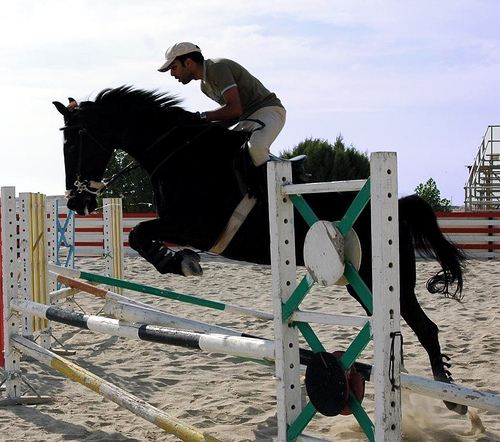

In [41]:
dataset[0][0]

In [42]:
target_names = []

for obj in dataset:
    target_names.extend([x['name'] for x in obj[1]['annotation']['object']])

target_names = list(set(target_names))

In [43]:
target_names

['car',
 'aeroplane',
 'boat',
 'bus',
 'train',
 'dog',
 'sofa',
 'bicycle',
 'chair',
 'bird',
 'bottle',
 'diningtable',
 'cat',
 'pottedplant',
 'motorbike',
 'sheep',
 'cow',
 'person',
 'tvmonitor',
 'horse']

In [44]:
target2idx = {name: i for i, name in enumerate(target_names)}
idx2target = {i: name for i, name in enumerate(target_names)}

target2idx, idx2target

({'car': 0,
  'aeroplane': 1,
  'boat': 2,
  'bus': 3,
  'train': 4,
  'dog': 5,
  'sofa': 6,
  'bicycle': 7,
  'chair': 8,
  'bird': 9,
  'bottle': 10,
  'diningtable': 11,
  'cat': 12,
  'pottedplant': 13,
  'motorbike': 14,
  'sheep': 15,
  'cow': 16,
  'person': 17,
  'tvmonitor': 18,
  'horse': 19},
 {0: 'car',
  1: 'aeroplane',
  2: 'boat',
  3: 'bus',
  4: 'train',
  5: 'dog',
  6: 'sofa',
  7: 'bicycle',
  8: 'chair',
  9: 'bird',
  10: 'bottle',
  11: 'diningtable',
  12: 'cat',
  13: 'pottedplant',
  14: 'motorbike',
  15: 'sheep',
  16: 'cow',
  17: 'person',
  18: 'tvmonitor',
  19: 'horse'})

In [45]:
def target_transform(voc_target):
    target = {}
    
    target['boxes'] = torch.tensor(
        [
            [
                float(x['bndbox']['xmin']),
                float(x['bndbox']['ymin']),
                float(x['bndbox']['xmax']),
                float(x['bndbox']['ymax'])
            ] for x in voc_target['annotation']['object']
        ],
        dtype=torch.float32
    )
    target['labels'] = torch.tensor([target2idx[x['name']] for x in voc_target['annotation']['object']], dtype=torch.int64)
    
    return target

In [46]:
target_transform(dataset[0][1])

{'boxes': tensor([[ 53.,  87., 471., 420.],
         [158.,  44., 289., 167.]]),
 'labels': tensor([19, 17])}

In [47]:
from torchvision.utils import draw_bounding_boxes


def show(imgs):
    to_pil = T.ToPILImage()
    
    if not isinstance(imgs, list):
        imgs = [imgs]
    fix, axs = plt.subplots(ncols=len(imgs), squeeze=False, figsize=(16, 8))
    for i, img in enumerate(imgs):
        img = img.detach()
        img = to_pil(img)
        axs[0, i].imshow(np.asarray(img))
        axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])

def draw_boxes_single_image(image, boxes, labels):
    colors = ["red" for _ in boxes]

    show(draw_bounding_boxes(image, boxes, labels, colors=colors, width=5))

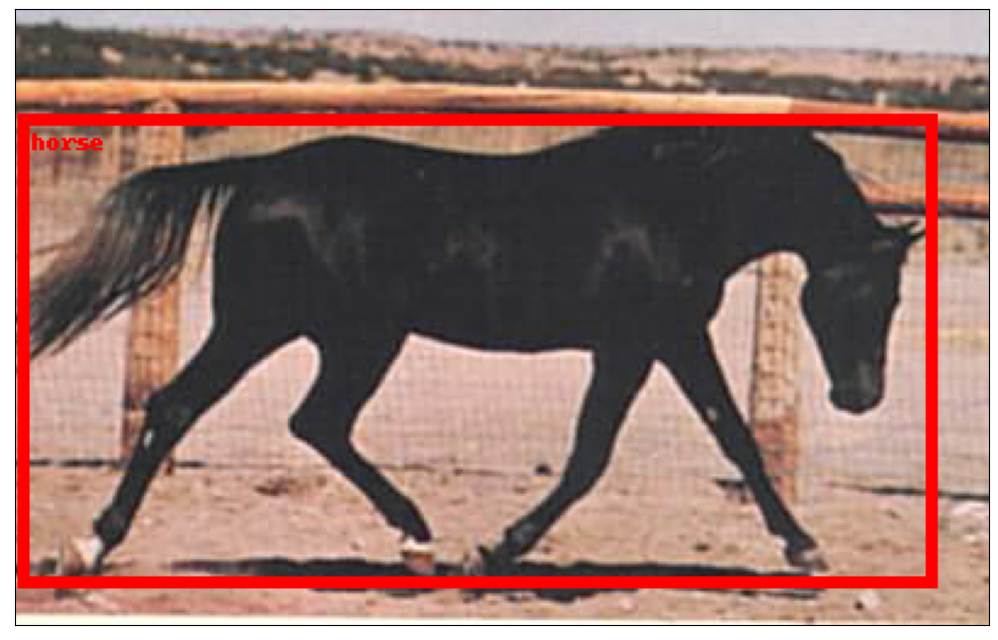

In [48]:
index = 105
draw_boxes_single_image(
    T.PILToTensor()(dataset[index][0]),
    target_transform(dataset[index][1])['boxes'],
    [idx2target[label.item()] for label in target_transform(dataset[index][1])['labels']]
)

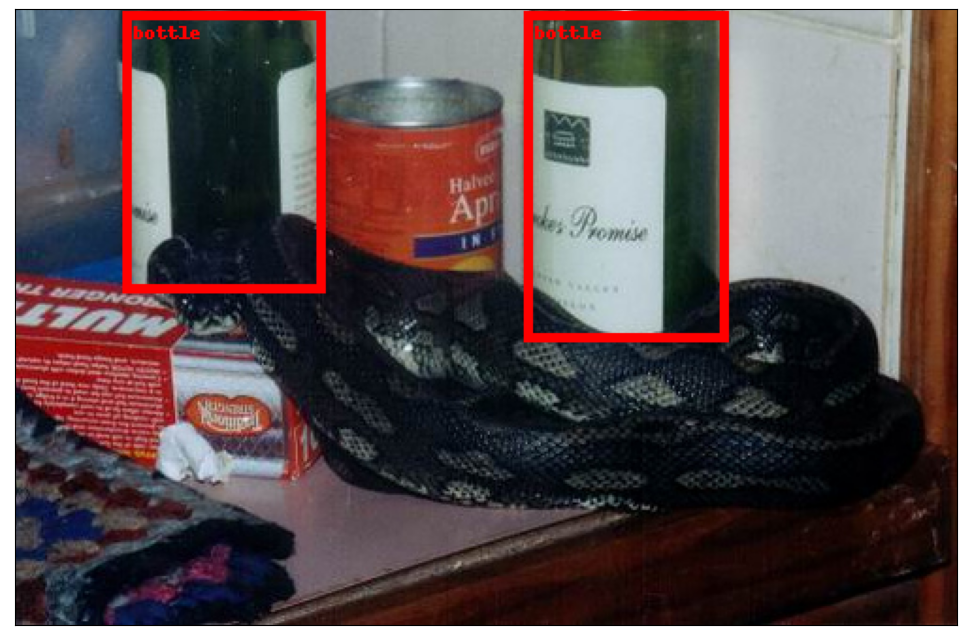

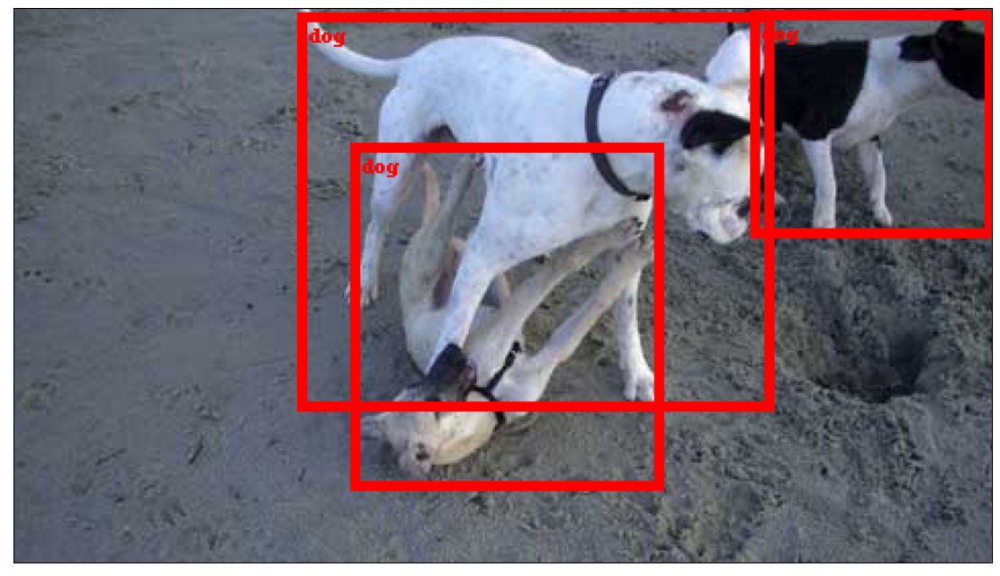

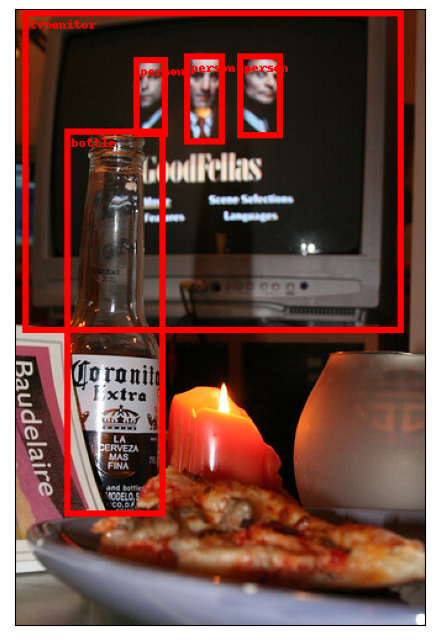

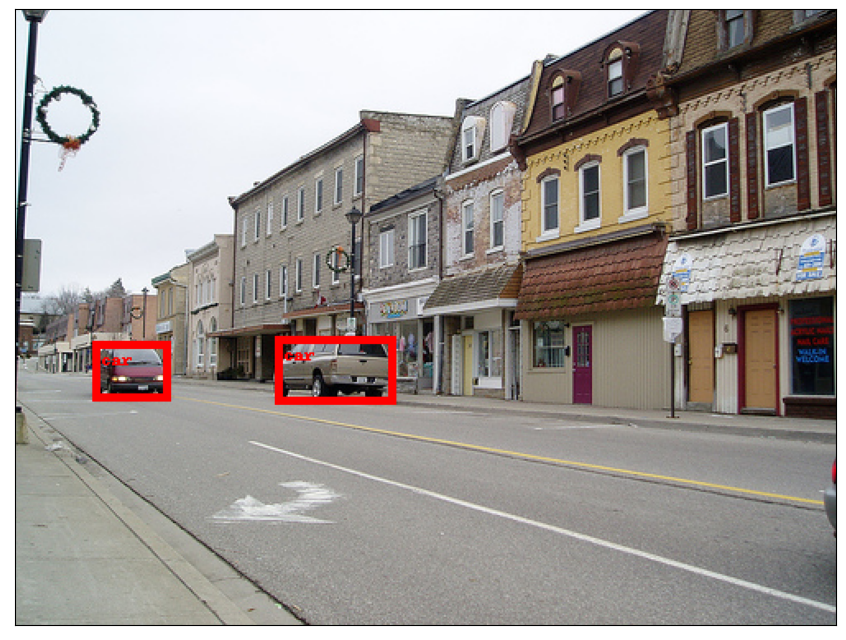

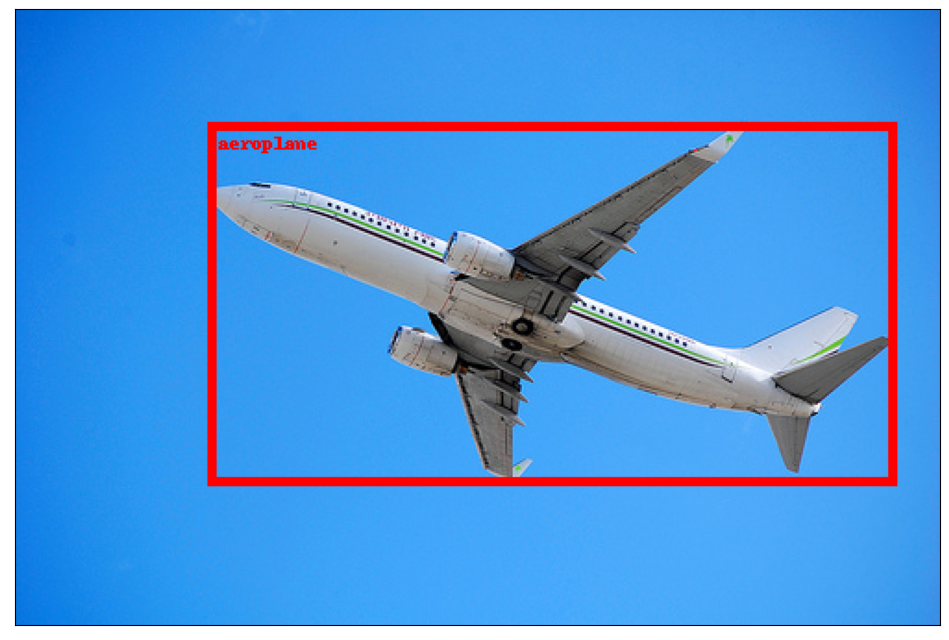

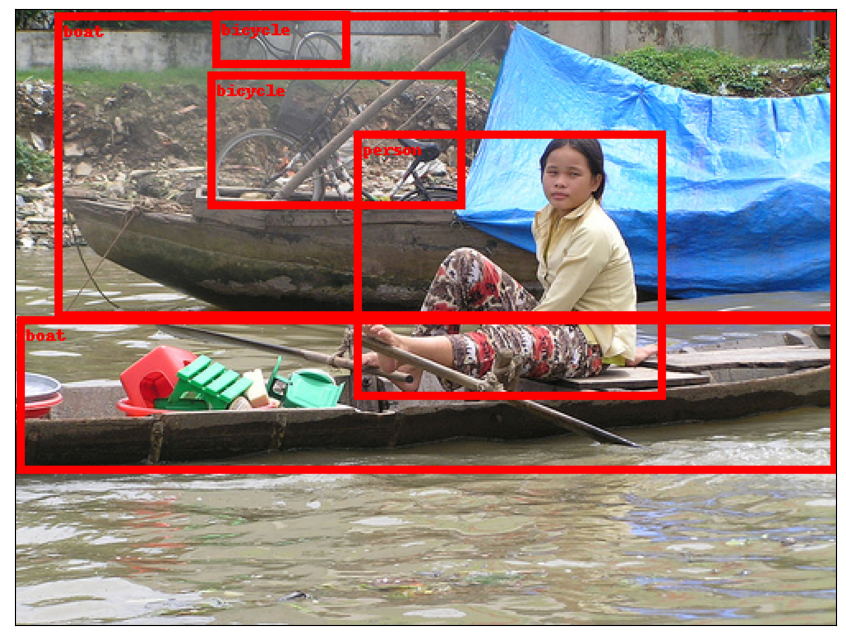

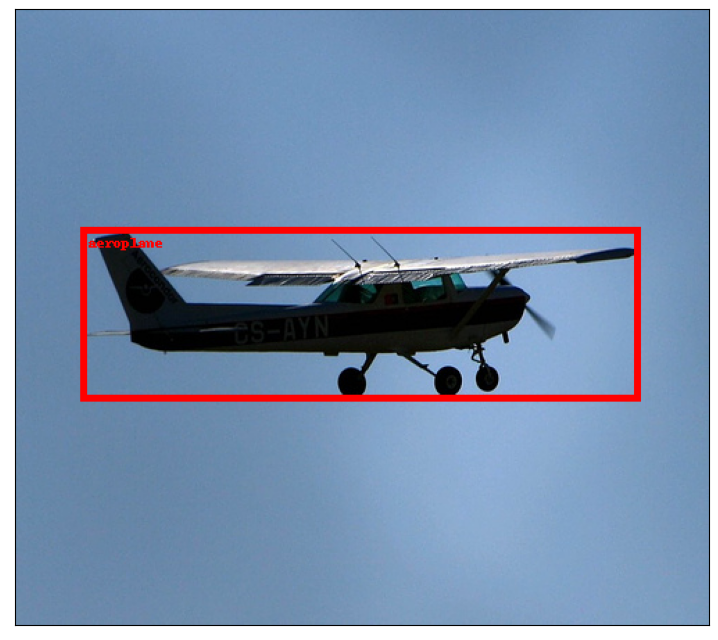

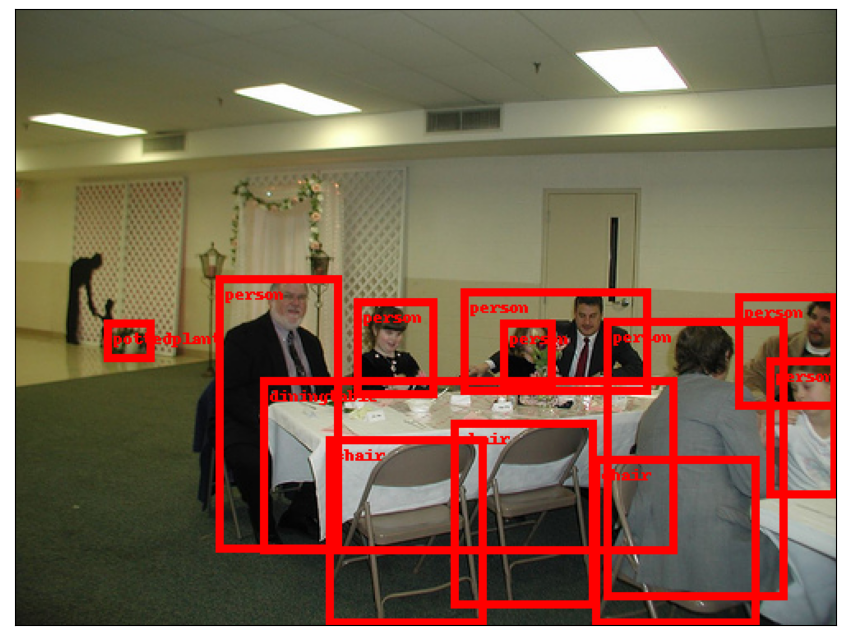

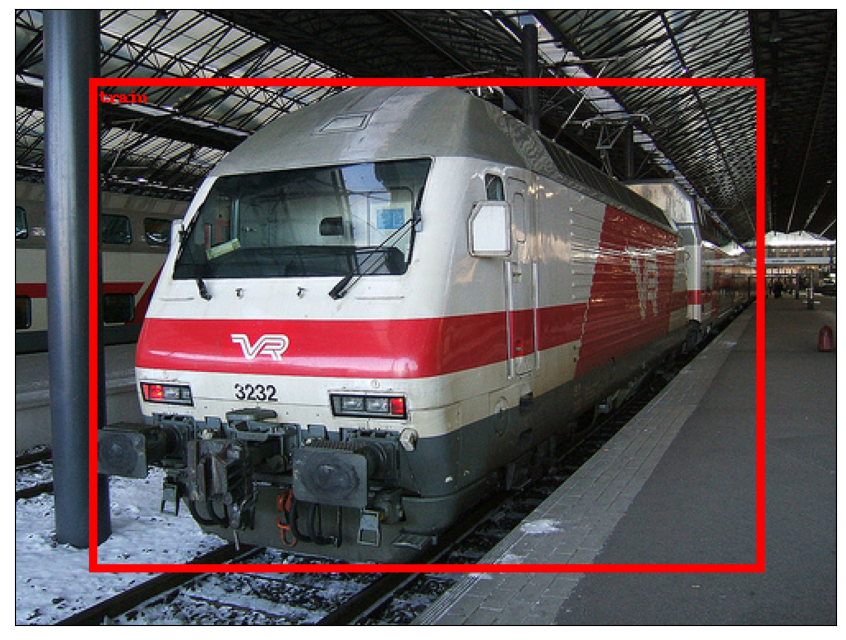

In [49]:
for i in range(1, 10):
    draw_boxes_single_image(
        T.PILToTensor()(dataset[i][0]),
        target_transform(dataset[i][1])['boxes'],
        [idx2target[label.item()] for label in target_transform(dataset[i][1])['labels']]
    )

In [51]:
def collate_fn(batch):
    return tuple(zip(*batch))

dataset_train = VOCDetection(
    'voc',
    image_set='train',
    transform=T.ToTensor(),
    target_transform=target_transform
)

dataset_test = VOCDetection(
    'voc',
    image_set='val',
    transform=T.ToTensor(),
    target_transform=target_transform
)

train_loader = DataLoader(dataset_train, batch_size=8, shuffle=True, num_workers=8, pin_memory=True, collate_fn=collate_fn)
valid_loader = DataLoader(dataset_test, batch_size=8, shuffle=False, num_workers=8, pin_memory=True, collate_fn=collate_fn)

In [61]:
from torchvision.models.detection import fasterrcnn_mobilenet_v3_large_320_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor


def get_detection_model():
    model = fasterrcnn_mobilenet_v3_large_320_fpn(pretrained=True)
    
    model.roi_heads.box_predictor = FastRCNNPredictor(1024, len(target_names))
    
    return model

In [62]:
model = get_detection_model()

model

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(320,), max_size=640, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): FrozenBatchNorm2d(16, eps=1e-05)
        (2): Hardswish()
      )
      (1): InvertedResidual(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=16, bias=False)
            (1): FrozenBatchNorm2d(16, eps=1e-05)
            (2): ReLU(inplace=True)
          )
          (1): Conv2dNormActivation(
            (0): Conv2d(16, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d(16, eps=1e-05)
          )
        )
      )
      (2): InvertedResidual(
        (block): 

In [53]:
%pip install torchmetrics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 529.6/529.6 kB 1.6 MB/s eta 0:00:0000:0100:01
Note: you may need to restart the kernel to use updated packages.


In [54]:
from torchmetrics.detection.mean_ap import MeanAveragePrecision
from torchvision.ops import batched_nms


def intersection_over_union(dt_bbox, gt_bbox):
    int_x0 = max(dt_bbox[0], gt_bbox[0])
    int_y0 = max(dt_bbox[1], gt_bbox[1])

    int_x1 = min(dt_bbox[2], gt_bbox[2])
    int_y1 = min(dt_bbox[3], gt_bbox[3])

    intersection = max(int_x1 - int_x0, 0) * max(int_y1 - int_y0, 0)
    dt_area = (dt_bbox[2] - dt_bbox[0]) * (dt_bbox[3] - dt_bbox[1])
    gt_area = (gt_bbox[2] - gt_bbox[0]) * (gt_bbox[3] - gt_bbox[1])

    return intersection / (dt_area + gt_area - intersection)


def apply_nms(orig_prediction, iou_thresh=0.3):
    
    keep = batched_nms(orig_prediction['boxes'], orig_prediction['scores'], orig_prediction['labels'], iou_thresh)

    final_prediction = orig_prediction

    final_prediction['boxes'] = final_prediction['boxes'][keep]
    final_prediction['scores'] = final_prediction['scores'][keep]
    final_prediction['labels'] = final_prediction['labels'][keep]
    
    return final_prediction


@torch.inference_mode()
def visualize(model, batch):
    model.eval()
    
    to_pil = T.ToPILImage()
    to_tensor = T.PILToTensor()

    xs, ys = batch

    for i, (x, y) in enumerate(zip(xs, ys)):
        prediction = {k: v.to(device) for k, v in model([x.to(device)])[0].items()}

        prediction = apply_nms(prediction)

        x = to_tensor(to_pil(x.cpu()))

        true_boxes = draw_bounding_boxes(x, boxes=y['boxes'], labels=[idx2target[label.item()] for label in y['labels']], width=5, colors='red')
        predicted_boxes = draw_bounding_boxes(x, boxes=prediction['boxes'], labels=[idx2target[label.item()] for label in prediction['labels']], width=5, colors='red')
        
        fig, ax = plt.subplots(1, 2, figsize=(20, 10), facecolor='white')

        ax[0].imshow(to_pil(true_boxes))
        ax[1].imshow(to_pil(predicted_boxes))

        ax[0].axis('off')
        ax[1].axis('off')

        ax[0].set_title('Target boxes')
        ax[1].set_title('Predicted boxes')

        plt.subplots_adjust(wspace=0, hspace=0.1)
        plt.show()

        if i >= 9:
            break

In [55]:
def train(model):
    model.train()

    for x, y in tqdm(train_loader, desc='Train'):
        x = list(_.to(device).float() for _ in x)
        y = [{k: v.to(device) for k, v in t.items()} for t in y]

        optimizer.zero_grad()

        output = model(x, y)
        
        loss_sum = sum(loss for loss in output.values())

        loss_sum.backward()

        optimizer.step()

In [56]:
@torch.inference_mode()
def evaluate(model, loader):
    model.eval()
    
    metric = MeanAveragePrecision()

    for x, y in tqdm(loader, desc='Evaluation'):
        x = list(_.to(device).float() for _ in x)

        output = model(x)
        
        output = [{k: v.cpu() for k, v in t.items()} for t in output]

        metric.update(output, y)

    return metric.compute()['map']

In [57]:
def plot_stats(
    train_map,
    valid_map,
    title
):
    plt.figure(figsize=(16, 8))

    plt.title(title + ' mAP')
    
    plt.plot(train_map, label='Train mAP')
    plt.plot(valid_map, label='Valid mAP')
    plt.legend()
    plt.grid()

    plt.show()

In [58]:
def whole_train_valid_cycle(model, num_epochs, title):
    batch = next(iter(valid_loader))

    for epoch in range(num_epochs):
        train(model)

        clear_output()

        visualize(model, batch)

In [64]:
model = get_detection_model().to(device)

optimizer = Adam([p for p in model.parameters() if p.requires_grad], lr=1e-4)

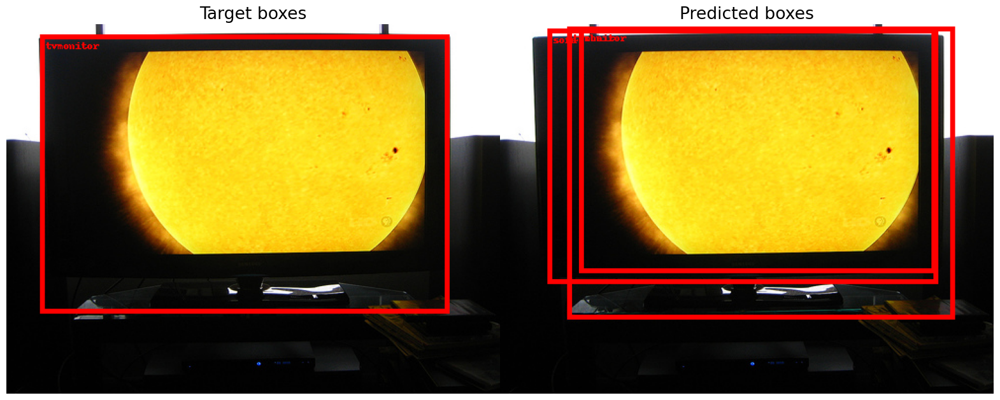

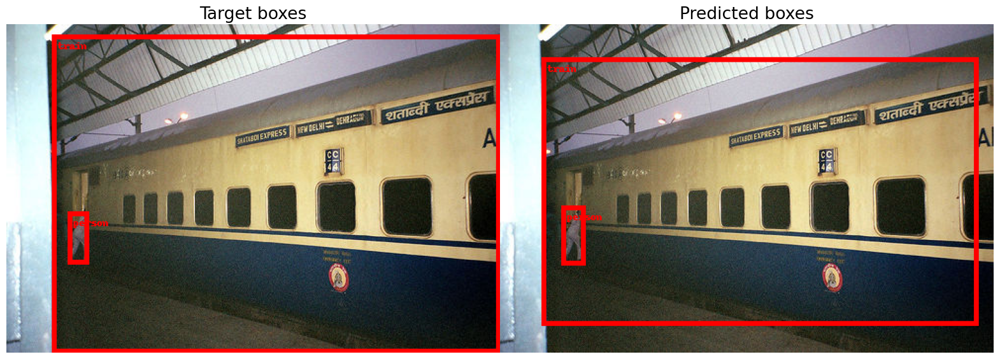

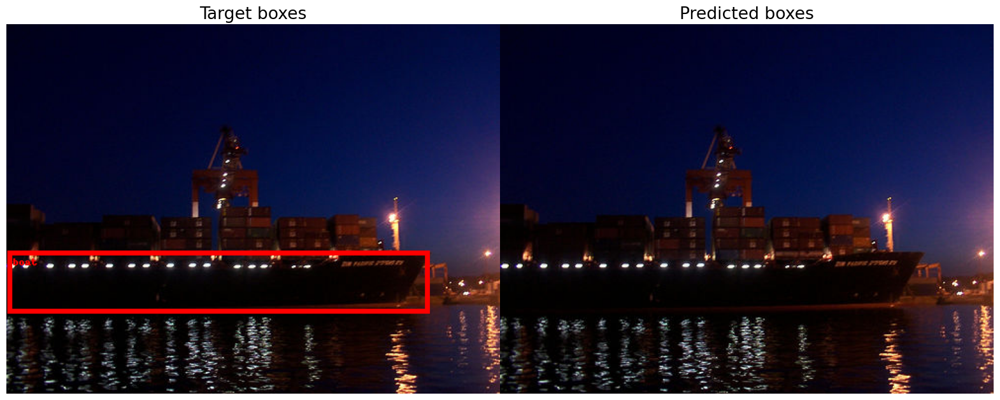

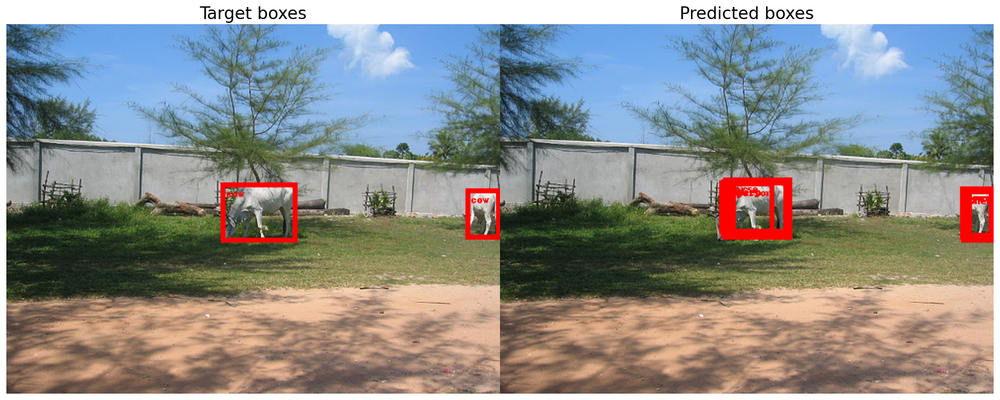

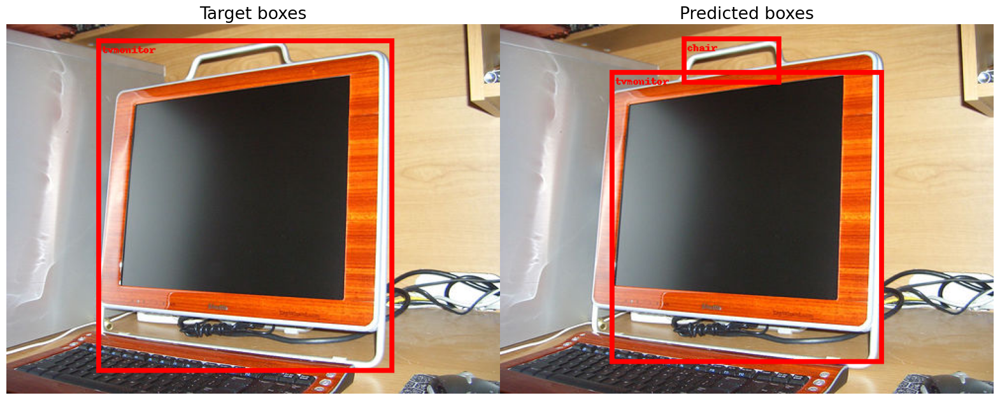

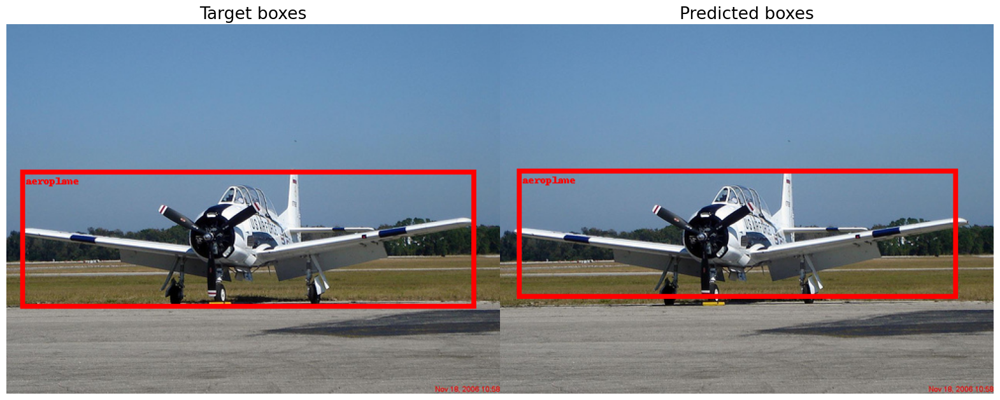

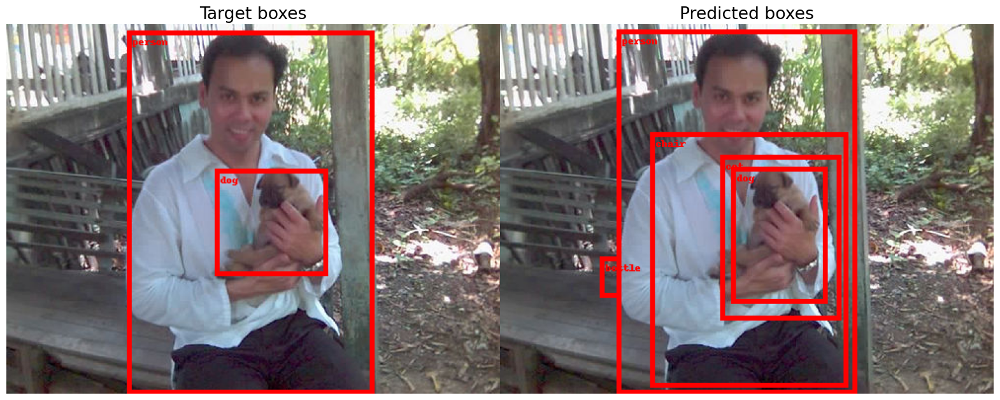

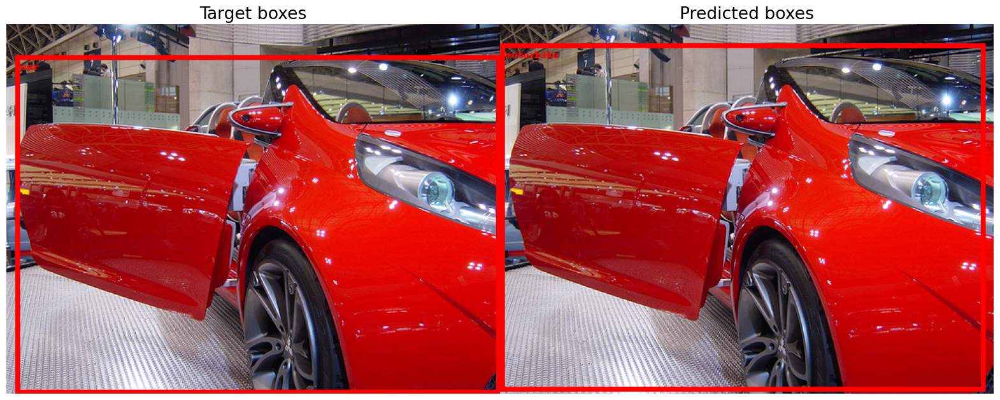

Train:  73%|███████████████████████████████████████████████████████████▏                     | 523/715 [00:19<00:07, 26.19it/s]

In [ ]:
whole_train_valid_cycle(model, 15, 'Faster R-CNN finetune')

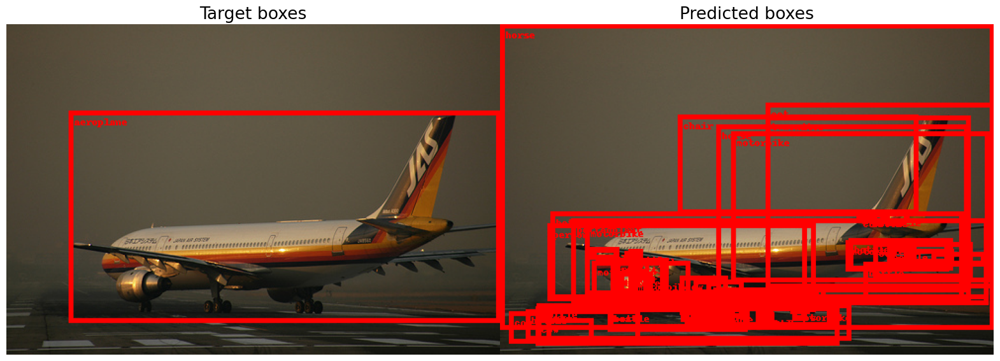

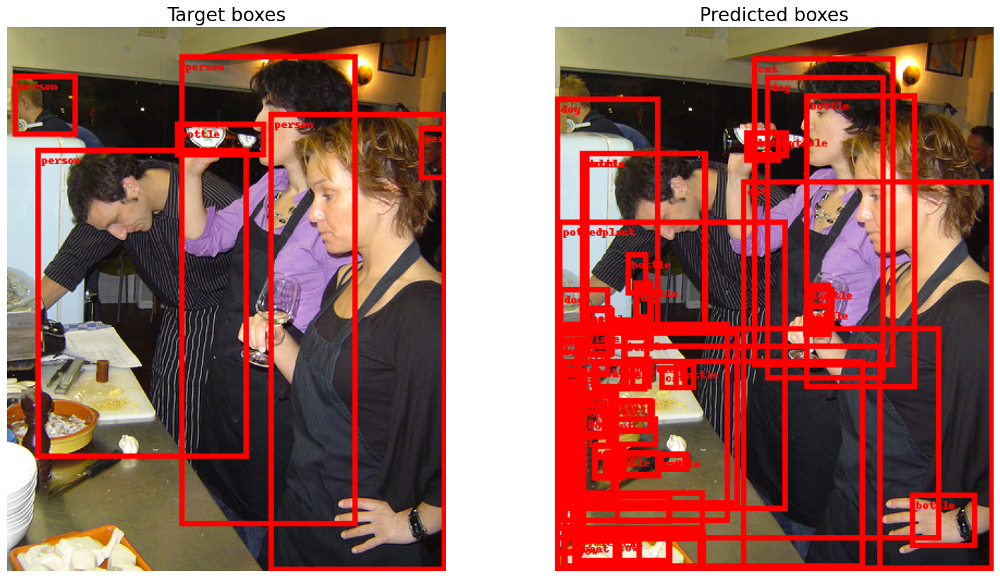

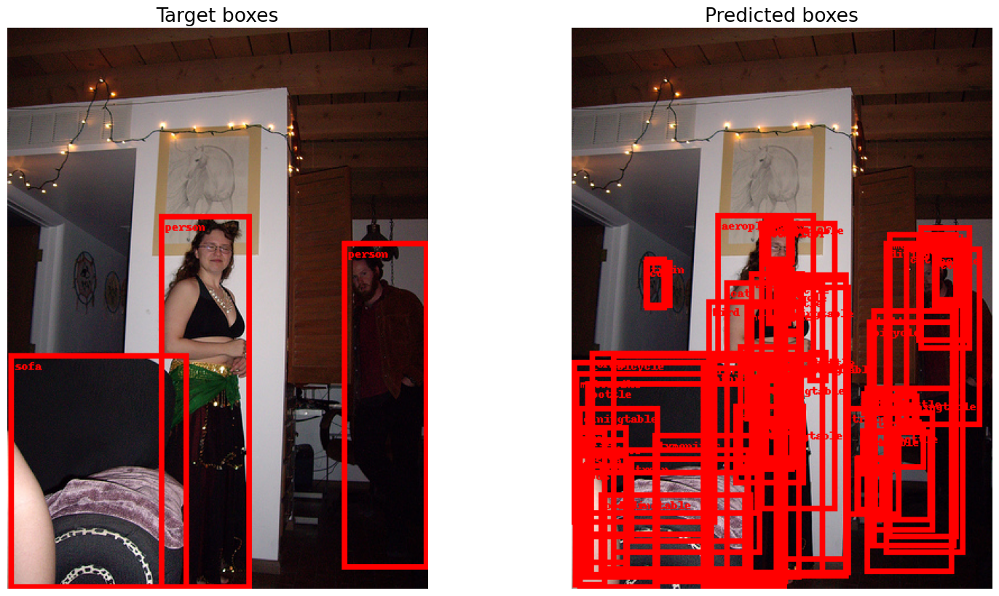

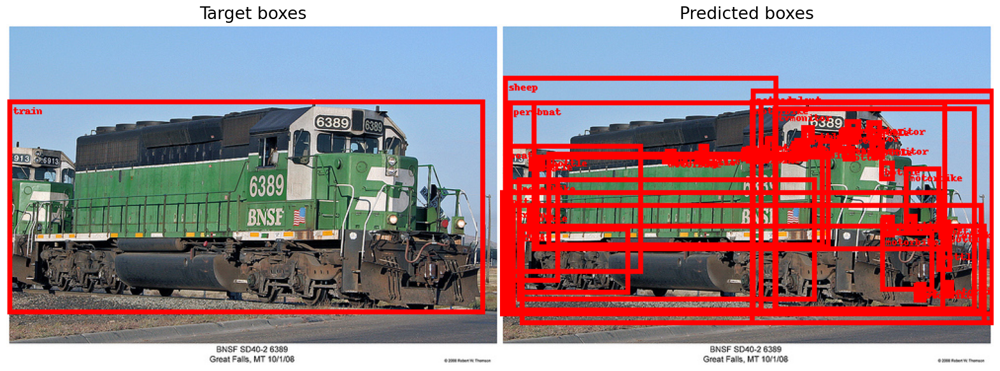

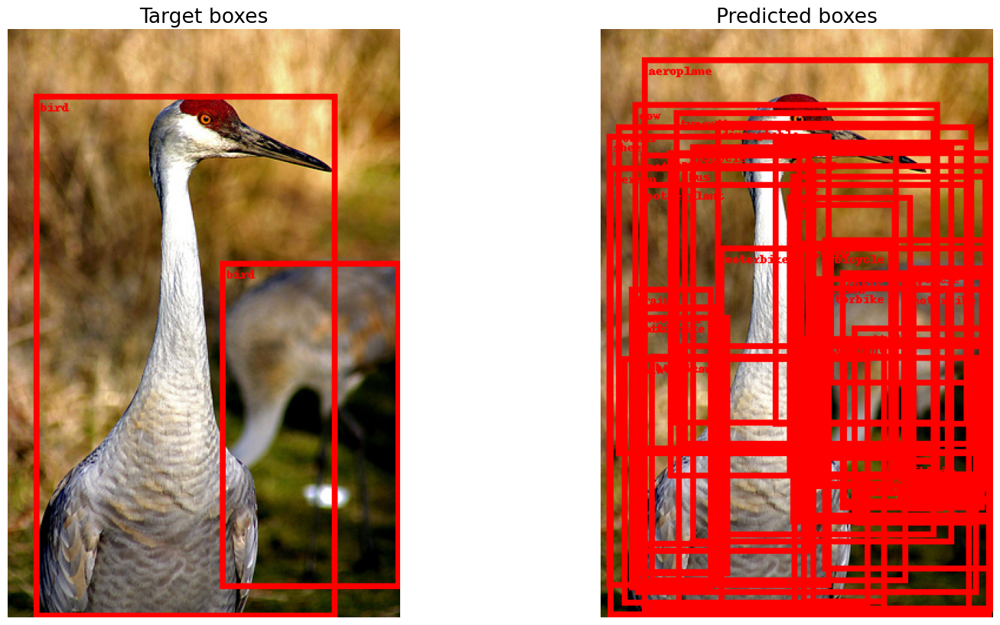

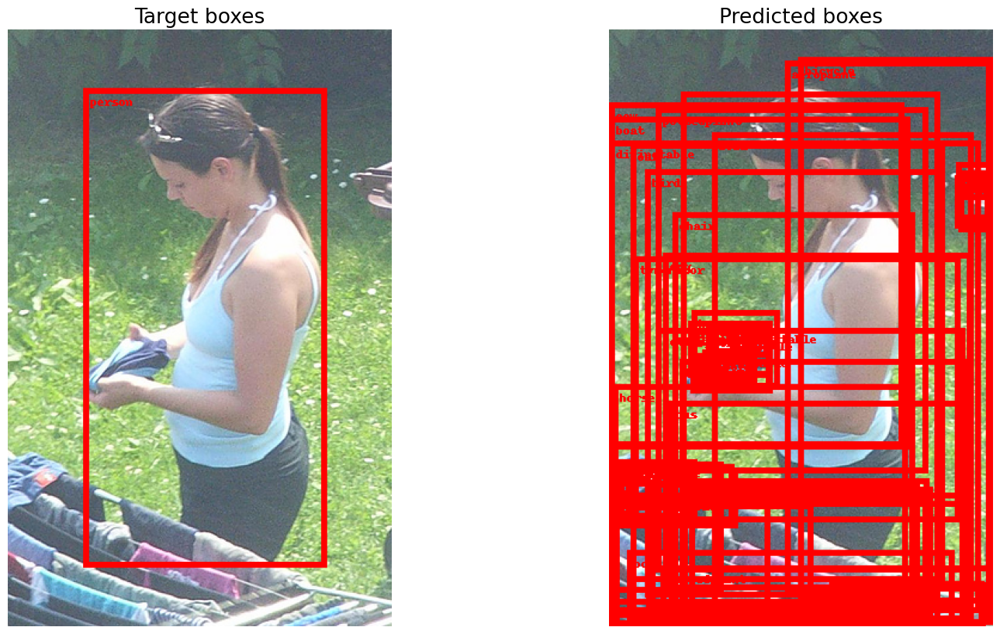

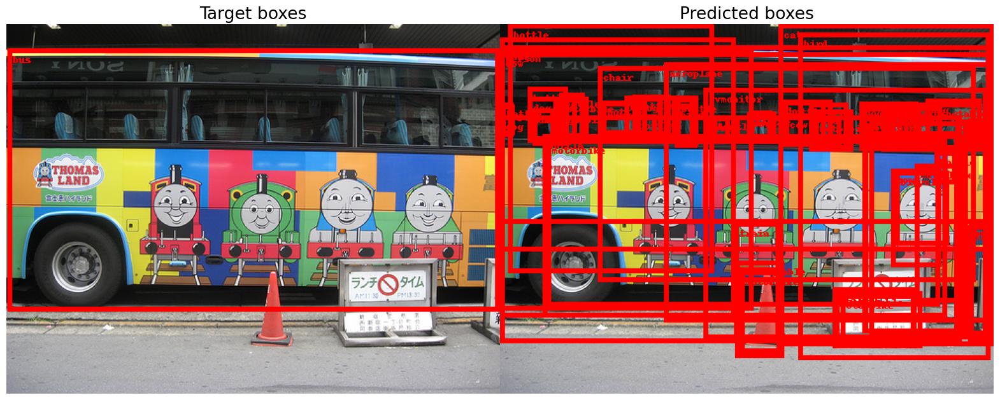

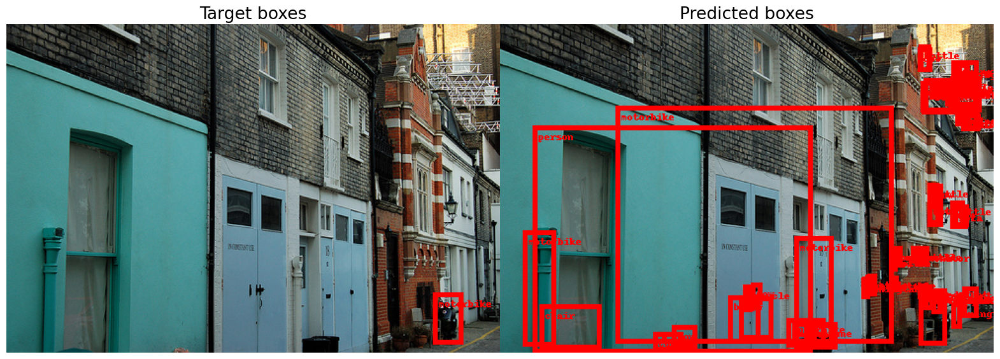

In [65]:
visualize(model, next(iter(train_loader)))

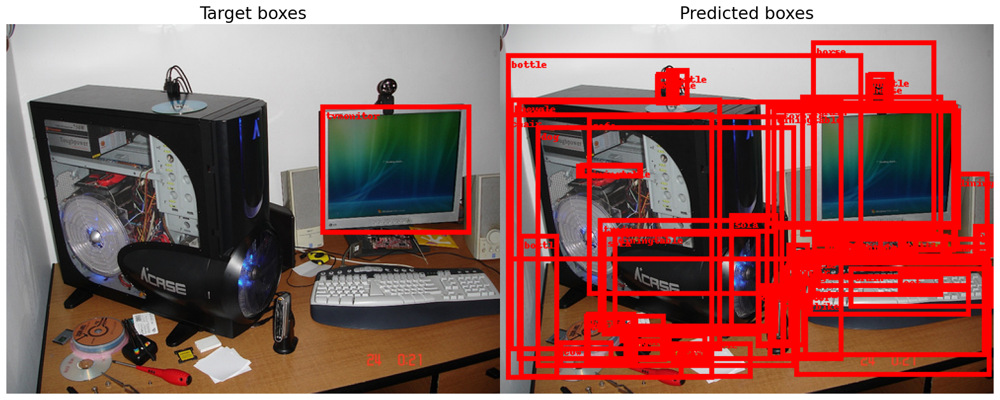

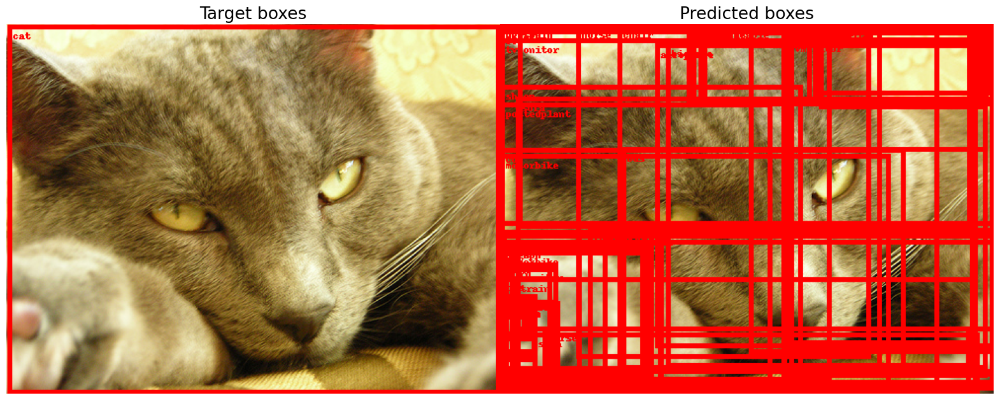

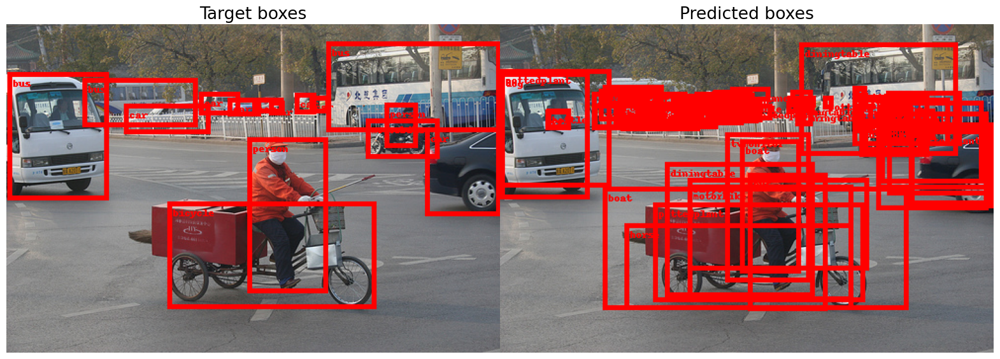

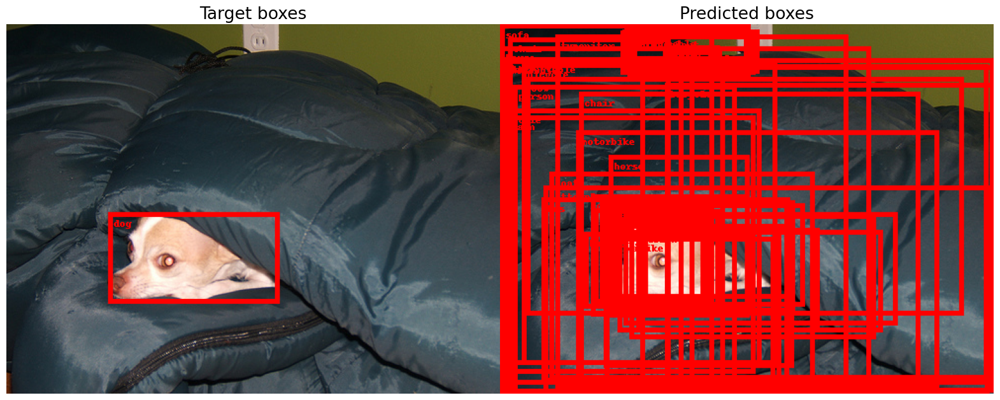

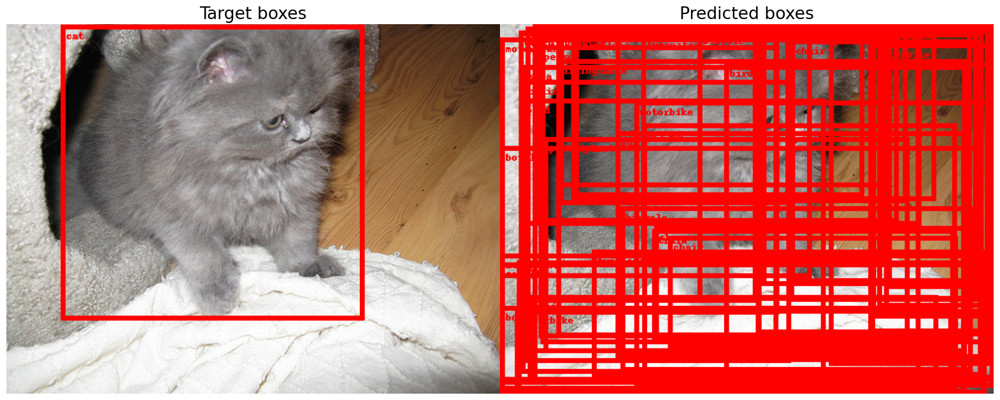

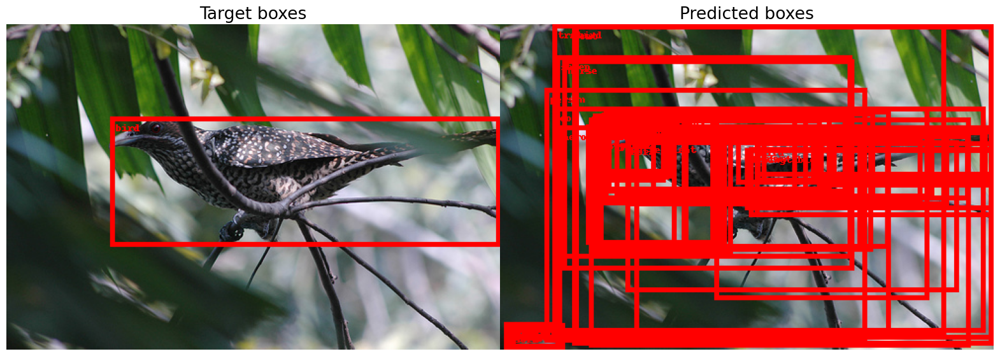

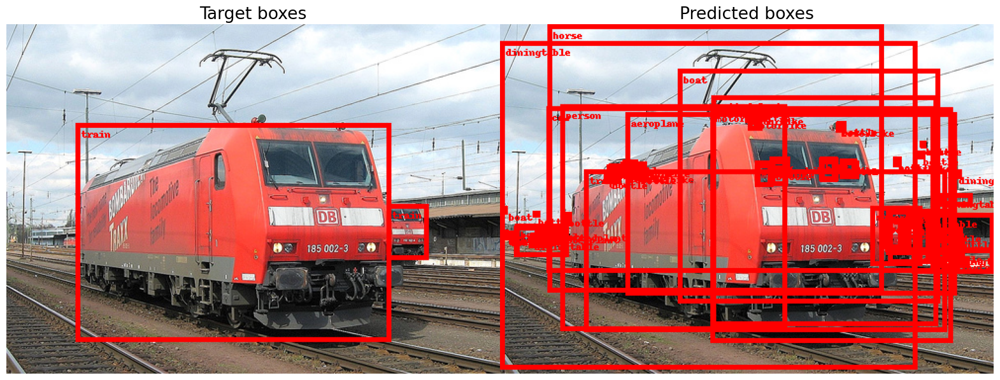

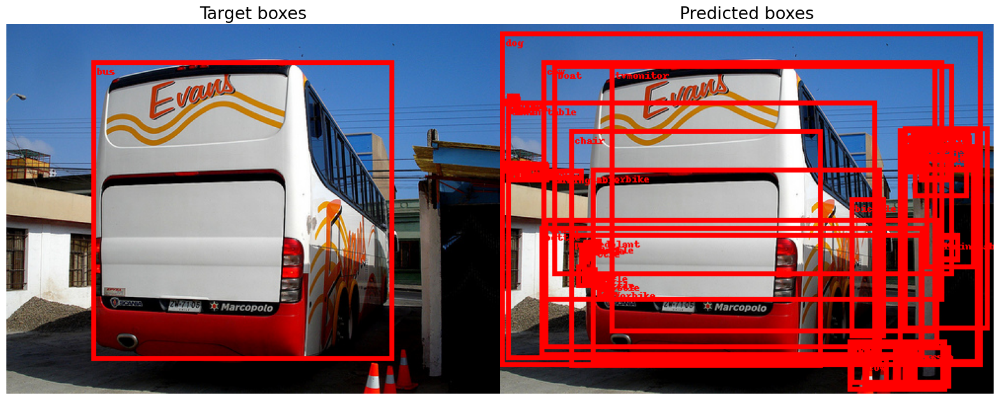

In [66]:
visualize(model, next(iter(train_loader)))

In [68]:
train_map = evaluate(model, train_loader)
valid_map = evaluate(model, valid_loader)

print(f'Train mAP {train_map:.5f} Valid mAP {valid_map:.5f}')

Evaluation: 100%|████████████████████████████████████████████████████████████████████████████| 728/728 [00:13<00:00, 52.67it/s]


Train mAP 0.37141 Valid mAP 0.32419


In [70]:
train_map = evaluate(model, train_loader)
valid_map = evaluate(model, valid_loader)

print(f'Train mAP {train_map:.5f} Valid mAP {valid_map:.5f}')

Evaluation: 100%|████████████████████████████████████████████████████████████████████████████| 728/728 [00:13<00:00, 53.03it/s]


Train mAP 0.53775 Valid mAP 0.35928
